In [ ]:
import numpy as np
import pandas as pd
import urllib.request
import json
import csv
import os
from bs4 import BeautifulSoup
import sys

from datetime import date

from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

In [2]:
def makeBatsmenClusterAgglomerative(clusterCount,distanceMeasure,linkageType,data):
    
    X = data.iloc[:, :].values
    #dendrogram = sch.dendrogram(sch.linkage(X, method='ward'))
    model = AgglomerativeClustering(n_clusters=clusterCount, affinity=distanceMeasure, linkage=linkageType)
    model.fit(X)
    labels = model.labels_
    return X,labels

In [3]:
import numpy as np
class HEOM():
    def __init__(self, X, cat_ix, nan_equivalents = [np.nan, 0], normalised="normal"):
        """ Heterogeneous Euclidean-Overlap Metric
        Distance metric class which initializes the parameters
        used in heom function
        
        Parameters
        ----------
        X : array-like of shape = [n_rows, n_features]
            First instance 
        
        cat_ix : array-like of shape = [cat_columns_number]
            List containing categorical feature indices
        
        cat_ix : array-like of shape = [x]
            List containing missing values indicators
        normalised: string
            normalises euclidan distance function for numerical variables
            Can be set as "std". Default is a column range
        Returns
        -------
        None
        """      
               
        self.nan_eqvs = nan_equivalents
        self.cat_ix = cat_ix
        self.col_ix = [i for i in range(X.shape[1])]
        # Get the normalization scheme for numerical variables
        if normalised == "std":
            self.range = 4* np.nanstd(X, axis = 0)
        else:
            self.range = np.nanmax(X, axis = 0) - np.nanmin(X, axis = 0)
    
    def heom(self, x, y):
        """ Distance metric function which calculates the distance
        between two instances. Handles heterogeneous data and missing values.
        It can be used as a custom defined function for distance metrics
        in Scikit-Learn
        
        Parameters
        ----------
        x : array-like of shape = [n_features]
            First instance 
            
        y : array-like of shape = [n_features]
            Second instance
        Returns
        -------
        result: float
            Returns the result of the distance metrics function
        """
        # Initialise results' array
        results_array = np.zeros(x.shape)

        # Get indices for missing values, if any
        nan_x_ix = np.flatnonzero( np.logical_or(np.isin(x, self.nan_eqvs), np.isnan(x)))
        nan_y_ix = np.flatnonzero( np.logical_or(np.isin(y, self.nan_eqvs), np.isnan(y)))
        nan_ix = np.unique(np.concatenate((nan_x_ix, nan_y_ix)))
        # Calculate the distance for missing values elements
        results_array[nan_ix] = 1

        # Get categorical indices without missing values elements
        cat_ix = np.setdiff1d(self.cat_ix, nan_ix)
        # Calculate the distance for categorical elements
        results_array[cat_ix]= np.not_equal(x[cat_ix], y[cat_ix]) * 1 # use "* 1" to convert it into int

        # Get numerical indices without missing values elements
        num_ix = np.setdiff1d(self.col_ix, self.cat_ix)
        num_ix = np.setdiff1d(num_ix, nan_ix)
        # Calculate the distance for numerical elements
        results_array[num_ix] = np.abs(x[num_ix] - y[num_ix]) / self.range[num_ix]
        
        # Return the final result
        # Square root is not computed in practice
        # As it doesn't change similarity between instances
        return np.sum(np.square(results_array))

# Batsman Clustering 

In [97]:
batsmenFolder = 'C:/python/Scripts/JupyterNotebooks/batsmanFeatures/'



In [368]:
###### This code extract the batting overall performance of all players from history till today ################


from urllib.request import urlopen
from bs4 import BeautifulSoup
import time
import sys

for page in range(1,878): #776 # pages count verify from the given link by checking last data page
   
    #theurl ="http://stats.espncricinfo.com/ci/engine/stats/index.html?class=2;page="+str(page)+";template=results;type=batting"
    theurl='http://stats.espncricinfo.com/ci/engine/stats/index.html?class=2;page='+str(page)+';filter=advanced;opposition=1;opposition=2;opposition=25;opposition=3;opposition=4;opposition=5;opposition=6;opposition=8;opposition=9;orderby=start;spanmax1=20+Oct+2019;spanmin1=01+Jan+2001;spanval1=span;team=1;team=2;team=25;team=3;team=4;team=5;team=6;team=7;team=8;team=9;template=results;type=batting;view=innings'
       
    #print(theurl)
    soup = BeautifulSoup(urlopen(theurl).read(), "html")
    soup.prettify()
    if(page==1):
        file = open(str(batsmenFolder)+"All_Players_Batting_Stats_ODI_from01Jan2001_to_20oct19.csv", 'w')

        ### player batting performance records header
       
        #file.write("Name,Id,Span,Match,Inns,totalBalls,totalRuns,wickets,BBI,Avg,Economy,StrikeRate,4 wicketsInInnings,5 wicketsInInnings"+"\n")
        
     ######################## Table header start    #######################    
        tablestats=soup.findAll("table", {"class" : "engineTable"}, limit=3)[2]
        data=tablestats.find("thead")
   
        row=data.findAll('tr', {"class" : "headlinks"})
        for col in row:
            data = col.findAll('th')
            for i in range(11):               
                if data[i].string!=None:
                    file.write(data[i].string)           
                file.write(',')
                if(i==0):
                    file.write('playerId,')
                    file.write('playerTeam,')
                if(i==1):
                    file.write('notOut,')
                if(i==10):
                    file.write('date,')
            file.write('\n')
        
    ######################## Table header ended    #######################
    tablestats=soup.findAll("table", {"class" : "engineTable"}, limit=3)[2]
    data=tablestats.find("tbody")
   
    row=data.findAll('tr', {"class" : "data1"})
    for col in row:
        data = col.findAll('td')       
        for i in range(12):
            if(data[1].string!='DNB'):
                if i<10 and data[i].find('a') is not None:
                    link = data[i].a['href']
                    file.write(str(data[i].a.string))
                    if(i==0):  
                        pteam = data[i].text.split('(')[1].split(')')[0]    # get player team which is present after his name
                        playerId = link.split('/')[4].split('.')[0]   # get player Id from hyper link of the row
                        file.write(','+playerId+',')
                        file.write(pteam)
                if i==1:
                    if(len(data[1].string.split('*'))>1):
                        file.write(str(data[1].string.split('*')[0])+',')
                        file.write('1')
                    else:
                        file.write(data[1].string)
                        file.write(',')
                        #file.write(',')


                if i!=1 and data[i].string!=None:
                    file.write(data[i].string)           
                file.write(',')
        if(data[1].string!='DNB'):     
            file.write('\n')
file.close()

In [537]:

## Get players' batting data data and preprocessing 


In [99]:
## Teams clustering values

batsmenData=  pd.read_csv(str(batsmenFolder)+"All_Players_Batting_Stats_ODI_preprocessedComplete.csv", sep=',')
batsmenData.head()
#batsmenData.drop(['Unnamed: 11','Unnamed: 15'], axis=1, inplace=True)
batsmenData.drop(['Unnamed: 0'], axis=1, inplace=True)

batsmenData.fillna(0)


# opposition_cluster = {"oppCluster":     {"Australia": 2, "Pakistan": 2,"New Zealand":1,"South Africa":1,"Sri Lanka":1,"India":1,
#                                    "England":1,"Zimbabwe":3,"Bangladesh":3,"West Indies":3}}
#batsmenData.replace(opposition_cluster, inplace=True)

batsmenData['oppCluster'] = batsmenData['Opposition']
teamClusteringData = pd.read_csv("C:/python/Scripts/JupyterNotebooks/teamFeatures/teamClustering_AvgMedRuns_clust_4.csv")

teamIds  = teamClusteringData['Name']  ## Name col
teamClusts = teamClusteringData['kMeansLabel'] 
#print(teamIds)
print('team Clust',len(teamIds))
for col in batsmenData.columns:
    if col.startswith('oppCluster'): 
        replace_team_clust = {col : {k: v for k,v in zip(teamIds,list(teamClusts))}}
        batsmenData.replace(replace_team_clust, inplace=True)
    
     

batsmenData.head(1)


team Clust 10


,Player,playerId,playerTeam,Runs,notOut,Mins,BF,4s,6s,SR,Inns,Opposition,Ground,date,oppCluster,Country,Continent
0,ADR Campbell,55301,ZIM,28,0,29,27,4,1,103.7,1,New Zealand,Taupo,2 Jan 2001,1,New Zealand,nonAsia


In [19]:
# worldCityCountryContinent= 'C:/python/Scripts/JupyterNotebooks/worldCityCountryContinent/'
# worldcities = pd.read_csv(str(worldCityCountryContinent)+"worldCitiesForAllCountriesRemDuplicates.csv", sep=',') #RemDuplicates
# worldCountryContinent = pd.read_csv(str(worldCityCountryContinent)+"countryContinentOnly.csv", sep=',')
# CityCountryContinent = pd.merge(worldcities,worldCountryContinent, on=['Country'])
# CityCountryContinent.head(1)

In [ ]:
# batsmenDataComplete= pd.DataFrame()
# batsmenDataComplete = pd.merge(batsmenData,CityCountryContinent,how='left', on=['Ground'])#,how='left' ,how='left'
# len(batsmenDataComplete)

In [20]:
# print(len(batsmenData))
# print(len(CityCountryContinent))

In [21]:
len(CityCountryContinent)

6357

In [22]:
batsmenDataComplete = batsmenData.copy()

In [23]:
len(batsmenDataComplete)

30563

In [100]:

batsmanFile = open(str(batsmenFolder)+'batsmenFeatureVectors.csv', 'w')
batsmanFile.write('Name,Id,InningsPlayed')#,below20,between21And40,between41And50,between51And70,between71And99,above100,')
batsmanFile.write(",")
for i in range(66):
    if(i==0 or i==65):
        batsmanFile.write("Asia")
    batsmanFile.write(",")

for i in range(66):
    if(i==0 or i==65):
        batsmanFile.write("nonAsia")
    batsmanFile.write(",")    
batsmanFile.write("\n")
batsmanFile.write(",")
batsmanFile.write(",")  
batsmanFile.write(",")
for k in range(2):
    for i in range(22):
        if(i==0 or i==21):
            batsmanFile.write("oppClust_1")
        batsmanFile.write(",")
    for i in range(22):
        if(i==0 or i==21):
            batsmanFile.write("oppClust_2")
        batsmanFile.write(",")
    for i in range(22):
        if(i==0 or i==21):
            batsmanFile.write("oppClust_3")
        batsmanFile.write(",")
batsmanFile.write("\n")
batsmanFile.write(",")
batsmanFile.write(",")  
batsmanFile.write(",")
for k in range(6):
    for i in range(11):
        if(i==0 or i==10):
            batsmanFile.write("inng1")
        batsmanFile.write(",") 
    for i in range(11):
        if(i==0 or i==10):
            batsmanFile.write("inng2")
        batsmanFile.write(",") 
batsmanFile.write("\n")
batsmanFile.write(",")
batsmanFile.write(",")  
batsmanFile.write(",")
for i in range(12):
    batsmanFile.write("run_blw20,bw21and40,bw41and50,bw51and70,bw71and99,abv100,SR_blw70,btw70and120,abv120,homeRuns,notOut")
    batsmanFile.write(",")

batsmanFile.write("\n")
  


#### Preprocessing of data   #############

batsmenDataComplete = batsmenDataComplete.drop(batsmenDataComplete[batsmenDataComplete['Runs']=="TDNB"].index)
batsmenDataComplete = batsmenDataComplete.drop(batsmenDataComplete[batsmenDataComplete['Runs']=="absent"].index)
batsmenDataComplete = batsmenDataComplete.drop(batsmenDataComplete[batsmenDataComplete['Runs']=="sub"].index)

batsmenDataComplete = batsmenDataComplete.replace('-', 0)
batsmenDataComplete = batsmenDataComplete.fillna(0)
batsmenDataComplete['playerId'] = batsmenDataComplete['playerId'].astype(int)
batsmenDataComplete['4s'] = batsmenDataComplete['4s'].astype(int)
batsmenDataComplete['6s'] = batsmenDataComplete['6s'].astype(int)
batsmenDataComplete['Runs'] = batsmenDataComplete['Runs'].astype(int)
batsmenDataComplete['SR'] = batsmenDataComplete['SR'].astype(float)
batsmenDataComplete['notOut'] = batsmenDataComplete['notOut'].astype(int) 
batsmenDataComplete['Inns'] = batsmenDataComplete['Inns'].astype(int)
batsmenDataComplete['oppCluster'] = batsmenDataComplete['oppCluster'].astype(int)

#### preprocessing ends  ###########

playerIds = batsmenDataComplete['playerId'].unique()
print("Total Unique Batsmen in this data:",len(playerIds))

oppositionCluster = batsmenDataComplete["oppCluster"].unique()
#oppositionCluster=[1,2,3]

batsmenDataComplete.to_csv(str(batsmenFolder)+'All_Players_Batting_Stats_ODI_preprocessedComplete.csv')

#batsmanFile.write('\n')
#playerIDs = [42639,55301,44708] #,
matchCount=[]
venueContinent = ['Asia','nonAsia']
for player in  playerIds: # playerIDs: #
    #playerMatchCountOverall=len(playersData[playersData['playerId']==player]['Player'])
    #print('match Count',playerMatchCountOverall)
    #matchCount.append(playerMatchCountOverall)
    playerName  = batsmenDataComplete[batsmenDataComplete['playerId']==player]['Player'].iloc[0]
    totalMatchCount=len(batsmenDataComplete[batsmenDataComplete['playerId']==player])
    #totalMatchCount=len(batsmenDataComplete[batsmenDataComplete['playerId']==player])
    
    #print(totalMatchCount)
    batsmanFile.write(str(playerName))
    
    batsmanFile.write(',')
    batsmanFile.write(str(player))
    batsmanFile.write(',')
    batsmanFile.write(str(totalMatchCount))
    batsmanFile.write(',')
    for venue in venueContinent: #range(2):    # Venue class (two--> Asia , nonAsia)
        for oppTeam in oppositionCluster:
            for inngs in range(1,3):  
                
                #print(player,playerName,oppTeam)
                #boundariesCount=0
               
                currentPlayerData =   batsmenDataComplete[(batsmenDataComplete['playerId']==int(player)) & (batsmenDataComplete['Continent']==str(venue)) & (batsmenDataComplete['oppCluster']==int(oppTeam)) & (batsmenDataComplete['Inns']==inngs)]
                if(len(currentPlayerData)>0):
                    #print(currentPlayerData['Opposition'].iloc[0])
                    matchCount        =   len(currentPlayerData)
                    totalMatchCount= totalMatchCount+matchCount
                    boundariesCount   =   currentPlayerData['4s'].sum()+ currentPlayerData['6s'].sum()
                    notOutCount       =   currentPlayerData['notOut'].sum()
                    #print(matchCount,boundariesCount,notOutCount)
                    
                    ###########    Runs Histogram   #############
                    batsmanFile.write(str(round(len(currentPlayerData[currentPlayerData['Runs']<=20])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=21) & (currentPlayerData['Runs']<=40)])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=41) & (currentPlayerData['Runs']<=50)])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=51) & (currentPlayerData['Runs']<=70)])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=71) & (currentPlayerData['Runs']<=99)])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=100)])/matchCount,2)))
                    batsmanFile.write(',')
                    
                    ###########    Strike rate bins(histograms)   ##########
                    
                    batsmanFile.write(str(round(len(currentPlayerData[currentPlayerData['SR']<70])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['SR']>=70) & (currentPlayerData['SR']<=120)])/matchCount,2)))
                    batsmanFile.write(',')                  
                    batsmanFile.write(str(round(len(currentPlayerData[(currentPlayerData['SR']>120)])/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(boundariesCount/matchCount,2)))
                    batsmanFile.write(',')
                    batsmanFile.write(str(round(notOutCount/matchCount,2))) #str(matchCount/)+'  '+
                    batsmanFile.write(',')
    
    batsmanFile.write('\n')
                    
batsmanFile.close()

c:\python\lib\site-packages\pandas\core\ops\__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


Total Unique Batsmen in this data: 1002


In [101]:
batsmanDf  = pd.read_csv(str(batsmenFolder)+"batsmenFeatureVectors.csv",sep=',', skiprows=3)

In [102]:

batsmanDf = batsmanDf.fillna(0)
batsmanDf = batsmanDf.replace('-', 0)
batsmanDf = batsmanDf.dropna(how='all', axis=1)
#bowlingFeatureVectors  = bowlerDf[bowlerDf.columns[~bowlerDf.columns.isin(['Unnamed: 0','Unnamed: 1','Unnamed: 2','Unnamed: 159'])]]

for col in batsmanDf.columns:
    if(col!='Unnamed: 0' and col!='Unnamed: 1' and col!='Unnamed: 2' and  col!='Unnamed: 135'):
    #for i in range(10):
        maxVal = batsmanDf[col].max()
        minVal = batsmanDf[col].min()
        batsmanDf[col] = round((batsmanDf[col]- minVal)/ (maxVal- minVal),2)        
batsmanDf.to_csv(str(batsmenFolder)+"batsmen_featuresSetNormalized.csv")
batsmanDf.head(2)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,run_blw20,bw21and40,bw41and50,bw51and70,bw71and99,abv100,SR_blw70,...,bw41and50.11,bw51and70.11,bw71and99.11,abv100.11,SR_blw70.11,btw70and120.11,abv120.11,homeRuns.11,notOut.11,Unnamed: 135
0,ADR Campbell,55301,33,0.0,0.33,0.0,0.0,0.67,0.0,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,TN Madondo,55571,5,1.0,0.00,0.0,0.0,0.00,0.0,0.67,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [103]:

clusterCount=4
distanceMeasure = 'euclidean'
linkageType='average'
battingFeatureVectors  = batsmanDf[batsmanDf.columns[~batsmanDf.columns.isin(['Unnamed: 0','Unnamed: 1','Unnamed: 2','Unnamed: 135'])]]


Y,batsmenLabels = makeBatsmenClusterAgglomerative(clusterCount,distanceMeasure,linkageType,battingFeatureVectors)
#print(batsmenLabels)
batsmanDf['AggClusters4']= batsmenLabels
#len(batsmenLabels)
#teamLabels[teamFeatureData[teamFeatureData['Name']=='N'].index[0]]

In [104]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4,n_init=50, max_iter =10000,  random_state=100).fit(np.array(battingFeatureVectors))
print(kmeans.labels_)

batsmanDf['kmeansLabels']= kmeans.labels_
batsmanDf.to_csv(str(batsmenFolder)+'batsmenClusters_4.csv')


[1 2 1 ... 2 2 2]


# Bolwer Clustering ####


In [105]:
bowlersFolder = 'C:/python/Scripts/JupyterNotebooks/bowlersFeatures/'

In [1]:
###### This code extract the batting overall performance of all players from history till today ################

from urllib.request import urlopen
from bs4 import BeautifulSoup
import time
import sys

for page in range(1,877): #776 # pages count verify from the given link by checking last data page
   
    #theurl ="http://stats.espncricinfo.com/ci/engine/stats/index.html?class=2;page="+str(page)+";template=results;type=batting"
    theurl='http://stats.espncricinfo.com/ci/engine/stats/index.html?class=2;page='+str(page)+';filter=advanced;opposition=1;opposition=2;opposition=25;opposition=3;opposition=4;opposition=5;opposition=6;opposition=8;opposition=9;orderby=start;spanmax1=20+Oct+2019;spanmin1=01+Jan+2001;spanval1=span;team=1;team=2;team=25;team=3;team=4;team=5;team=6;team=7;team=8;team=9;template=results;type=bowling;view=innings'
    
    print(page)   
    #print(theurl)
    soup = BeautifulSoup(urlopen(theurl).read(), "html")
    soup.prettify()
    if(page==1):
        file = open(str(bowlersFolder)+"All_Players_Bolwing_Stats_ODI_from01Jan2001_to_20Oct19.csv", 'w')

        ### player batting performance records header
       
        #file.write("Name,Id,Span,Match,Inns,totalBalls,totalRuns,wickets,BBI,Avg,Economy,StrikeRate,4 wicketsInInnings,5 wicketsInInnings"+"\n")
        
     ######################## Table header start    #######################    
        tablestats=soup.findAll("table", {"class" : "engineTable"}, limit=3)[2]
        data=tablestats.find("thead")
   
        row=data.findAll('tr', {"class" : "headlinks"})
        for col in row:
            data = col.findAll('th')
            for i in range(len(data)):               
                if data[i].string!=None:
                    file.write(data[i].string)           
                    file.write(',')
                if(i==0):
                    file.write('playerId,')
                    file.write('playerTeam,')
#                 if(i==1):
#                     file.write('notOut,')
                if(i==9):
                    file.write('date,')
            file.write('\n')
        
    ######################## Table header ended    #######################
    tablestats=soup.findAll("table", {"class" : "engineTable"}, limit=3)[2]
    data=tablestats.find("tbody")
   
    row=data.findAll('tr', {"class" : "data1"})
    for col in row:
        data = col.findAll('td')       
        for i in range(len(data)):
            if(data[1].string!='DNB'):
                if i<9 and data[i].find('a') is not None:
                    link = data[i].a['href']
                    file.write(str(data[i].a.string))
                    if(i==0):  
                        pteam = data[i].text.split('(')[1].split(')')[0]    # get player team which is present after his name
                        playerId = link.split('/')[4].split('.')[0]   # get player Id from hyper link of the row
                        file.write(','+playerId+',')
                        file.write(pteam)
                    file.write(',')
#                 if i==1:
#                     if(len(data[1].string.split('*'))>1):
#                         file.write(str(data[1].string.split('*')[0])+',')
#                         file.write('1')
#                     else:
#                         file.write(data[1].string)
#                         file.write(',')
#                         #file.write(',')

                
                if data[i].string!=None:  # i!=1 andi!=5 and 
                    if(i==5 and data[i].text!='-'):
                        file.write(str(float(data[i].text)))    ## Bowlers economy       
                    else:    
                        file.write(data[i].string)
                    file.write(',')
        if(data[1].string!='DNB'):     
            file.write('\n')
file.close()

In [106]:
bowlersData=  pd.read_csv(str(bowlersFolder)+"All_Players_Bolwing_Stats_ODI_from01Jan2001_to_20Oct19.csv", sep=',')
bowlersData.head()
#bowlersData.drop(['Unnamed: 12'], axis=1, inplace=True)
bowlersData.fillna(0)


,Player,playerId,playerTeam,Overs,Mdns,Runs,Wkts,Econ,Inns,Opposition,Ground,date,bowlSR
0,CL Cairns,36597,NZ,3,0,24,0,8,1,Zimbabwe,Taupo,02-Jan-01,18
1,CS Martin,37700,NZ,7,0,53,0,7.57,1,Zimbabwe,Taupo,02-Jan-01,42
2,SB Styris,38407,NZ,10,0,60,1,6,1,Zimbabwe,Taupo,02-Jan-01,60
3,JEC Franklin,37004,NZ,5,0,28,2,5.6,1,Zimbabwe,Taupo,02-Jan-01,15
4,CZ Harris,37232,NZ,5,0,41,0,8.2,1,Zimbabwe,Taupo,02-Jan-01,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...
21808,Usman Shinwari,697279,PAK,8,1,41,1,5.12,1,Sri Lanka,Karachi,02-Oct-19,48
21809,Iftikhar Ahmed,480603,PAK,9,1,43,0,4.77,1,Sri Lanka,Karachi,02-Oct-19,54
21810,Wahab Riaz,43590,PAK,10,0,81,1,8.1,1,Sri Lanka,Karachi,02-Oct-19,60
21811,Shadab Khan,922943,PAK,9,0,50,1,5.55,1,Sri Lanka,Karachi,02-Oct-19,54


In [107]:
## Teams clustering values


bowlersData['oppCluster'] = bowlersData['Opposition']


teamClusteringData = pd.read_csv("C:/python/Scripts/JupyterNotebooks/teamFeatures/teamClustering_AvgMedRuns_clust_4.csv")

teamIds  = teamClusteringData['Name']  ## Name col
teamClusts = teamClusteringData['kMeansLabel'] 
#print(teamIds)
print('team Clust',len(teamIds))
for col in bowlersData.columns:
    if col.startswith('oppCluster'): 
        replace_team_clust = {col : {k: v for k,v in zip(teamIds,list(teamClusts))}}
        bowlersData.replace(replace_team_clust, inplace=True)
    
     
# opposition_cluster = {"oppCluster":     {"Australia": 2, "Pakistan": 2,"New Zealand":1,"South Africa":1,"Sri Lanka":1,"India":1,
#                                    "England":1,"Zimbabwe":3,"Bangladesh":3,"West Indies":3}}

# bowlersData.replace(opposition_cluster, inplace=True)



bowlersData.head(1)

worldCityCountryContinent= 'C:/python/Scripts/JupyterNotebooks/worldCityCountryContinent/'
worldcities = pd.read_csv(str(worldCityCountryContinent)+"worldCitiesForAllCountriesRemDuplicates.csv", sep=',') #RemDuplicates
worldCountryContinent = pd.read_csv(str(worldCityCountryContinent)+"countryContinentOnly.csv", sep=',')
CityCountryContinent = pd.merge(worldcities,worldCountryContinent, on=['Country'])
CityCountryContinent.head(1)

team Clust 10


,Ground,Country,Continent
0,Lebowakgomo,South Africa,nonAsia


In [108]:
bowlersDataComplete= pd.DataFrame()
bowlersDataComplete = pd.merge(bowlersData,CityCountryContinent,how='left', on=['Ground'])#,how='left' ,how='left'

In [109]:
bowlersDataComplete.head(2)

,Player,playerId,playerTeam,Overs,Mdns,Runs,Wkts,Econ,Inns,Opposition,Ground,date,bowlSR,oppCluster,Country,Continent
0,CL Cairns,36597,NZ,3,0,24,0,8,1,Zimbabwe,Taupo,02-Jan-01,18,1,New Zealand,nonAsia
1,CS Martin,37700,NZ,7,0,53,0,7.57,1,Zimbabwe,Taupo,02-Jan-01,42,1,New Zealand,nonAsia


In [110]:
len(bowlersDataComplete)

21813

In [111]:

bowlerFile = open(str(bowlersFolder)+'bowlersFeatureVectors.csv', 'w')
bowlerFile.write('Name,Id,InningsPlayed')#,below20,between21And40,between41And50,between51And70,between71And99,above100,')
bowlerFile.write(",")
for i in range(78):
    if(i==0 or i==77):
        bowlerFile.write("Asia")
    bowlerFile.write(",")

for i in range(78):
    if(i==0 or i==77):
        bowlerFile.write("nonAsia")
    bowlerFile.write(",")    
bowlerFile.write("\n")
bowlerFile.write(",")
bowlerFile.write(",")  
bowlerFile.write(",")
for k in range(2):
    for i in range(26):
        if(i==0 or i==25):
            bowlerFile.write("oppClust_1")
        bowlerFile.write(",")
    for i in range(26):
        if(i==0 or i==25):
            bowlerFile.write("oppClust_2")
        bowlerFile.write(",")
    for i in range(26):
        if(i==0 or i==25):
            bowlerFile.write("oppClust_3")
        bowlerFile.write(",")
bowlerFile.write("\n")
bowlerFile.write(",")
bowlerFile.write(",")  
bowlerFile.write(",")
for k in range(6):
    for i in range(13):
        if(i==0 or i==12):
            bowlerFile.write("inng1")
        bowlerFile.write(",") 
    for i in range(13):
        if(i==0 or i==12):
            bowlerFile.write("inng2")
        bowlerFile.write(",") 
bowlerFile.write("\n")
bowlerFile.write(",")
bowlerFile.write(",")  
bowlerFile.write(",")
for i in range(12):
    bowlerFile.write("avg_blw15,bw16and30,bw30and50,abv50,econ_blw3,btw4and6,btw7and9,abv9,SR_blw10,btw11and20,btw21and30,btw31and50,abv50")
    bowlerFile.write(",")

bowlerFile.write("\n")
  


#### Preprocessing of data   #############

bowlersDataComplete = bowlersDataComplete.drop(bowlersDataComplete[bowlersDataComplete['Runs']=="TDNB"].index)
bowlersDataComplete = bowlersDataComplete.drop(bowlersDataComplete[bowlersDataComplete['Runs']=="absent"].index)
bowlersDataComplete = bowlersDataComplete.drop(bowlersDataComplete[bowlersDataComplete['Runs']=="sub"].index)
bowlersDataComplete = bowlersDataComplete.drop(bowlersDataComplete[bowlersDataComplete['Overs']=="TDNB"].index)
bowlersDataComplete = bowlersDataComplete.drop(bowlersDataComplete[bowlersDataComplete['Overs']=="sub"].index)


bowlersDataComplete = bowlersDataComplete.replace('-', 0)
bowlersDataComplete = bowlersDataComplete.fillna(0)
bowlersDataComplete['playerId'] = bowlersDataComplete['playerId'].astype(int)

bowlersDataComplete['Runs'] = bowlersDataComplete['Runs'].astype(int)
bowlersDataComplete['Econ'] = bowlersDataComplete['Econ'].astype(float)
bowlersDataComplete['Wkts'] = bowlersDataComplete['Wkts'].astype(int)
bowlersDataComplete['Overs'] = bowlersDataComplete['Overs'].astype(float) 
bowlersDataComplete['Inns'] = bowlersDataComplete['Inns'].astype(int)
bowlersDataComplete['oppCluster'] = bowlersDataComplete['oppCluster'].astype(int)
bowlersDataComplete['bowlAvg'] = bowlersDataComplete['Runs']/bowlersDataComplete['Overs']
#bowlersDataComplete['bowlAvg'] =bowlersDataComplete['bowlAvg'].astype(float)
bowlersDataComplete['bowlSR'] = bowlersDataComplete['bowlSR'].astype(float) #(bowlersDataComplete['Overs']*6) /bowlersDataComplete['Wkts']



#### preprocessing ends  ###########

playerIds = bowlersDataComplete['playerId'].unique()
print("Total Unique bowlers in this data:",len(playerIds))

oppositionCluster = bowlersDataComplete["oppCluster"].unique()
oppositionCluster=[1,2,3]

bowlersDataComplete.to_csv(str(bowlersFolder)+'All_Players_Bowling_Stats_ODI_preprocessedComplete.csv')

#bowlerFile.write('\n')
playerIDs = [42639,234675,42655] #,
matchCount=[]
venueContinent = ['Asia','nonAsia']
for player in  playerIds: #  playerIDs: #
    
    #playerMatchCountOverall=len(playersData[playersData['playerId']==player]['Player'])
    #print('match Count',playerMatchCountOverall)
    #matchCount.append(playerMatchCountOverall)
    playerName  = bowlersDataComplete[bowlersDataComplete['playerId']==player]['Player'].iloc[0]
    totalMatchCount=len(bowlersDataComplete[bowlersDataComplete['playerId']==player])
    #print(totalMatchCount)
    bowlerFile.write(str(playerName))
    
    bowlerFile.write(',')
    bowlerFile.write(str(player))
    bowlerFile.write(',')
    bowlerFile.write(str(totalMatchCount))
    bowlerFile.write(',')
    for venue in venueContinent: #range(2):    # Venue class (two--> Asia , nonAsia)
        for oppTeam in oppositionCluster:
            for inngs in range(1,3):  
                
                #print(player,playerName,oppTeam)
                #boundariesCount=0
               
                currentPlayerData =   bowlersDataComplete[(bowlersDataComplete['playerId']==int(player)) & (bowlersDataComplete['Continent']==str(venue)) & (bowlersDataComplete['oppCluster']==int(oppTeam)) & (bowlersDataComplete['Inns']==inngs)]
                if(len(currentPlayerData)>0):
                    #print(currentPlayerData['Opposition'].iloc[0])
                    matchCount        =   len(currentPlayerData)
                    totalMatchCount= totalMatchCount+matchCount
                    #boundariesCount   =   currentPlayerData['4s'].sum()+ currentPlayerData['6s'].sum()
                    #notOutCount       =   currentPlayerData['notOut'].sum()
                    #print(matchCount,boundariesCount,notOutCount)
                    
                    ###########    Runs conceded Histogram   #############
                    bowlerFile.write(str(round(len(currentPlayerData[currentPlayerData['Runs']<15])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=15) & (currentPlayerData['Runs']<=30)])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>=31) & (currentPlayerData['Runs']<=50)])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['Runs']>50)])/matchCount,2)))
                    bowlerFile.write(',')
                    
                    
                     
                    ###########    Strike rate bins(histograms)   ##########
                    
                    bowlerFile.write(str(round(len(currentPlayerData[currentPlayerData['bowlSR']<10])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['bowlSR']>=11) & (currentPlayerData['bowlSR']<=20)])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['bowlSR']>=21) & (currentPlayerData['bowlSR']<=30)])/matchCount,2)))
                    bowlerFile.write(',') 
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['bowlSR']>=31) & (currentPlayerData['bowlSR']<=50)])/matchCount,2)))
                    bowlerFile.write(',')    
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['bowlSR']>50)])/matchCount,2)))
                    bowlerFile.write(',')
                    
                    
                    
                    ###########    Strike rate bins(histograms)   ##########
                    
                    bowlerFile.write(str(round(len(currentPlayerData[currentPlayerData['Econ']<3])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['Econ']>=3) & (currentPlayerData['Econ']<=6)])/matchCount,2)))
                    bowlerFile.write(',')
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['Econ']>=7) & (currentPlayerData['Econ']<=9)])/matchCount,2)))
                    bowlerFile.write(',')                                                 
                    bowlerFile.write(str(round(len(currentPlayerData[(currentPlayerData['Econ']>9)])/matchCount,2)))
                    bowlerFile.write(',')
                    
#                     bowlerFile.write(str(round(boundariesCount/matchCount,2)))
#                     bowlerFile.write(',')
#                     bowlerFile.write(str(round(notOutCount/matchCount,2))) #str(matchCount/)+'  '+
#                     bowlerFile.write(',')
    
    bowlerFile.write('\n')
                    
bowlerFile.close()

Total Unique bowlers in this data: 802


In [112]:
bowlersDataComplete.head(2)

,Player,playerId,playerTeam,Overs,Mdns,Runs,Wkts,Econ,Inns,Opposition,Ground,date,bowlSR,oppCluster,Country,Continent,bowlAvg
0,CL Cairns,36597,NZ,3.0,0,24,0,8.00,1,Zimbabwe,Taupo,02-Jan-01,18.0,1,New Zealand,nonAsia,8.000000
1,CS Martin,37700,NZ,7.0,0,53,0,7.57,1,Zimbabwe,Taupo,02-Jan-01,42.0,1,New Zealand,nonAsia,7.571429


In [113]:

### Read bowlers feature vectors and apply Min- Max normalization on each column
bowlerDf =pd.read_csv(str(bowlersFolder)+'bowlersFeatureVectors.csv', sep=',', skiprows=3)
bowlerDf.head(2)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,avg_blw15,bw16and30,bw30and50,abv50,econ_blw3,btw4and6,btw7and9,...,econ_blw3.11,btw4and6.11,btw7and9.11,abv9.11,SR_blw10.11,btw11and20.11,btw21and30.11,btw31and50.11,abv50.23,Unnamed: 159
0,CL Cairns,36597,50,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,CS Martin,37700,17,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [114]:


bowlerDf = bowlerDf.fillna(0)
bowlerDf = bowlerDf.replace('-', 0)
#bowlingFeatureVectors  = bowlerDf[bowlerDf.columns[~bowlerDf.columns.isin(['Unnamed: 0','Unnamed: 1','Unnamed: 2','Unnamed: 159'])]]

for col in bowlerDf.columns:
    if(col!='Unnamed: 0' and col!='Unnamed: 1' and col!='Unnamed: 2'):
    #for i in range(10):
        maxVal = bowlerDf[col].max()
        minVal = bowlerDf[col].min()
        bowlerDf[col] = round((bowlerDf[col]- minVal)/ (maxVal- minVal),2)        
bowlerDf.to_csv(str(bowlersFolder)+"bowlers_featuresSetNormalized.csv")
bowlerDf.head()

,Unnamed: 0,Unnamed: 1,Unnamed: 2,avg_blw15,bw16and30,bw30and50,abv50,econ_blw3,btw4and6,btw7and9,...,econ_blw3.11,btw4and6.11,btw7and9.11,abv9.11,SR_blw10.11,btw11and20.11,btw21and30.11,btw31and50.11,abv50.23,Unnamed: 159
0,CL Cairns,36597,50,0.00,1.00,0.0,0.0,0.0,1.00,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
1,CS Martin,37700,17,0.00,0.00,0.0,1.0,0.0,0.00,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2,SB Styris,38407,113,1.00,0.00,0.0,0.0,0.0,0.00,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3,JEC Franklin,37004,79,0.00,0.00,1.0,0.0,0.0,1.00,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
4,CZ Harris,37232,58,0.67,0.33,0.0,0.0,0.0,0.67,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN


In [115]:
bowlerDf =pd.read_csv(str(bowlersFolder)+'bowlers_featuresSetNormalized.csv', sep=',', skiprows=0)
bowlerDf.head()


clusterCount=4
distanceMeasure = 'euclidean'
linkageType='average'
bowlerDf= bowlerDf.fillna(0)
bowlingFeatureVectors  = bowlerDf[bowlerDf.columns[~bowlerDf.columns.isin(['Unnamed: 0','Unnamed: 0.1','Unnamed: 1','Unnamed: 2','Unnamed: 159'])]]

bowlingFeatureVectors.head()

Y,bowlersLabels = makeBatsmenClusterAgglomerative(clusterCount,distanceMeasure,linkageType,bowlingFeatureVectors)
#print(batsmenLabels)
bowlerDf['AggClusters3']= bowlersLabels
#len(batsmenLabels)
#teamLabels[teamFeatureData[teamFeatureData['Name']=='N'].index[0]]

In [116]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4,n_init=50, max_iter =10000,  random_state=100).fit(np.array(bowlingFeatureVectors))
#print(kmeans.labels_)




In [117]:
bowlerDf['kMeansLabels'] =kmeans.labels_
bowlerDf.to_csv(str(bowlersFolder)+"bowlersClustering_4.csv")

In [8]:
########################## ###############################

# Start of Innings runs prediction 

In [ ]:
# -*- coding: utf-8 -*-
"""
Created on Wed May 23 22:25:17 2018
Updated on Mon Nov-11  2019
@author: Naimat
"""



import pandas as pd
import numpy as np
import urllib.request
import json
import csv
import os
from bs4 import BeautifulSoup
import sys
# reload(sys)
# sys.setdefaultencoding('utf-8')
# import time

# df = pd.DataFrame()
dataFramesList_ = []
import_matchFileLocation= 'C:/python/Scripts/JupyterNotebooks/matchSummary/'#'F:/LUMS/Cricket Data/Data Files/Match Detail only/'

allODIMatchesSummaryDataframe= pd.DataFrame()
list_of_files = os.listdir(import_matchFileLocation) #list of files in the given directory
dataMatrix =[]
# for each_file in list_of_files:
    
#     if each_file.startswith('Matches_2'):  #since its all type str you can simply use startswith
        
#         with open(import_matchFileLocation+each_file, 'r') as csvfile:
#             dataRows=[]
#             csvreader = csv.reader(csvfile)
#             next(csvreader)
#             for row in csvreader:
#                 dataRows.append(row)
                
#                 dataMatrix.append(row)

#                 # do stuff with rows...
#                 #print(each_file)

#         #df = pd.read_csv(import_matchFileLocation+each_file,index_col=None,header=0) #, header=0,
#         #print(len(df))
#         #dataFramesList_.append(df)
# allODIMatchesSummaryDataframe =pd.DataFrame(dataMatrix)# pd.concat(dataFramesList_)

# allODIMatchesSummaryDataframe.columns = ['team1', 'team2','winnerTeam','margin','ground','matchDate','year','matchNumber','URL','matchId']



## allODIMatchesSummaryDataframe

allMatchesSummary = pd.read_csv('allODIMatchesSummary_2001_2019.csv')##[allODIMatchesSummaryDataframe['matchId']==749797]
#allODIMatchesSummaryDataframe.copy() #
#allMatchesSummary1 = allMatchesSummary.copy()
allMatchesSummary['toss_winner_team'] = 0
allMatchesSummary['floodlit'] = -1
allMatchesSummary['home_team'] = 0
allMatchesSummary['rain_rule'] = 0
allMatchesSummary['adjusted'] = 0

allMatchesSummary['site_name'] = 0
allMatchesSummary['country_name'] = 0
allMatchesSummary['start_date'] = 0

allMatchesSummary['innings1Runs'] = 0
allMatchesSummary['innings1RunRate'] = 0
allMatchesSummary['innings1Wickets'] = 0
allMatchesSummary['innings1Extras'] = 0
allMatchesSummary['innings2Runs'] = 0
allMatchesSummary['innings2RunRate'] = 0
allMatchesSummary['innings2Wickets'] = 0
allMatchesSummary['innings2Extras'] = 0



def makeChangesInAllMatchesSummary(): 
#     import urllib.request
#     from bs4 import BeautifulSoup
#     import time
#     import sys
    dataFramesList_ = []
    i=0
    cou=0
    for matid in allMatchesSummary['matchId']:
        i=i+1
        if(matid!=924635):
            try:
                #print(str(matid)+' ' +str(cou))
                allMatchesSummary1 = allMatchesSummary[allMatchesSummary['matchId']==int(matid)]
                cou=cou+1
                #print(cou)
                #print(matid)
                pl1= "http://www.espncricinfo.com/ci/engine/match/"+str(matid)+".json?xhr=1"
                souppl1 = BeautifulSoup(urllib.request.urlopen(pl1).read(), "lxml")
                souppl1.prettify()
                w1=souppl1.find('body')
                b1=w1.text
                js1=str(b1)
                inp1=json.loads(js1)

                #print(allMatchSummaryDf.iloc[0]['Ground'])
                #dataFramesList_.append(playerPerfomanceStats)
                t0= inp1['team'][0]['team_name']
                t1=inp1['team'][1]['team_name']
                #print(t0)
                #print('Toss Winner Team',inp1['match']['toss_winner_team_id'])
                if(inp1['team'][0]['team_id'] == inp1['match']['toss_winner_team_id']):
                    #print(inp1['team'][0]['team_name'])
                    allMatchesSummary1.loc[:,'toss_winner_team']   = inp1['team'][0]['team_name']
                else:
                    #print(inp1['team'][1]['team_name'])
                    allMatchesSummary1.loc[:,'toss_winner_team']   = inp1['team'][1]['team_name']

                if(inp1['team'][0]['team_id'] == inp1['match']['home_team_id']):
                    #print(inp1['team'][0]['team_name'])
                    allMatchesSummary1.loc[:,'home_team']   = inp1['team'][0]['team_name']
                else:
                    #print(inp1['team'][1]['team_name']) 
                    allMatchesSummary1.loc[:,'home_team']   = inp1['team'][1]['team_name']
                #print(inp1['match']['floodlit'])
                #print(inp1['match']['home_team_id'])

                #allMatchesSummary1.loc[:,'home_team']   = inp1['match']['home_team_id']
                
                allMatchesSummary1.loc[:,'innings1Runs']   = inp1['innings'][0]['runs']
                allMatchesSummary1.loc[:,'innings1RunRate']   = inp1['innings'][0]['run_rate']
                allMatchesSummary1.loc[:,'innings1Wickets']   = inp1['innings'][0]['wickets']
                allMatchesSummary1.loc[:,'innings1Extras']   = inp1['innings'][0]['extras']
                
                
                allMatchesSummary1.loc[:,'innings2Runs']   = inp1['innings'][1]['runs']
                allMatchesSummary1.loc[:,'innings2RunRate']   = inp1['innings'][1]['run_rate']
                allMatchesSummary1.loc[:,'innings2Wickets']   = inp1['innings'][1]['wickets']
                allMatchesSummary1.loc[:,'innings2Extras']   = inp1['innings'][1]['extras']
                
                
                allMatchesSummary1.loc[:,'floodlit']   = inp1['match']['floodlit']
                allMatchesSummary1.loc[:,'adjusted']   = inp1['match']['adjusted']
                allMatchesSummary1.loc[:,'rain_rule'] =  inp1['match']['rain_rule']
                allMatchesSummary1.loc[:,'country_name'] =  inp1['match']['country_name']
                allMatchesSummary1.loc[:,'start_date'] =  inp1['match']['start_date']
                
                allMatchesSummary1.loc[:,'site_name'] =  inp1['match']['site_name']
                #print(allMatchesSummary1)
                dataFramesList_.append(allMatchesSummary1)
            except:
                print(str(matid)+' ' +str(cou))
                continue
            #if(i==30):
            #  break
    allMatchesDf = pd.concat(dataFramesList_)
    return allMatchesDf

allMatchesData = makeChangesInAllMatchesSummary()
print('Length the output dataframe:',len(allMatchesData))

c:\python\lib\site-packages\pandas\core\indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


1030223 2135
1030225 2136


In [70]:
allMatchSummary = pd.read_csv('C:/python/Scripts/JupyterNotebooks/matchSummary/allODIMatchesSummary_DetailInfo_2001_2019.csv', sep=',')

#allMatchSummary.drop(['Unnamed: 0'], axis=1, inplace=True)

allMatchSummary.year.unique()

array([2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019], dtype=int64)

In [71]:
len(allMatchSummary)

2552

In [72]:
allMatchSummary.head(1)


,team1,team2,winnerTeam,margin,ground,matchDate,year,matchNumber,URL,matchId,...,start_date,innings1Runs,innings1RunRate,innings1Wickets,innings1Extras,innings2Runs,innings2RunsExpected,innings2RunRate,innings2Wickets,innings2Extras
0,New Zealand,Zimbabwe,Zimbabwe,70 runs,Taupo,Jan-02,2001,ODI # 1663,/ci/engine/match/64687.html,64687,...,02-Jan-01,300,6.0,7,19,210,210.0,5.25,10,8


In [73]:
len(allMatchSummary[allMatchSummary['year']==2017])#.columns#.tail()

129

In [4]:
inning1BeforeStartProjectionFolder = 'C:/python/Scripts/JupyterNotebooks/BeforeStartofInngs1Features/'


In [85]:
#matchSummariesLocation =  'C:/python/All_ODIs_2001_19_top10Teams/' #'F:/LUMS/Cricket Data/Data Files/All ODIs/'

matchSummariesLocation= 'D:/F_Drive/LUMS/Cricket Data/Data Files/All ODIs/'

list_of_files = os.listdir(matchSummariesLocation)


matchRecordFile = open(str(inning1BeforeStartProjectionFolder)+'startOfInng1_team1Features_2001_19.csv','w')

matchRecordFile.write('matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning1RunRate,inning2Runs,innings2Wickets,inning2RunRate,')
for i in range(11):
    matchRecordFile.write('batsman,')
for i in range(11):
    if(i==10):
        matchRecordFile.write('bowler')
    else:
        matchRecordFile.write('bowler,')
           
matchRecordFile.write('\n')


teamName =  ['England','Australia','South Africa','West Indies','New Zealand','India','Pakistan','Sri Lanka','Zimbabwe','Bangladesh']

filter1 =  allMatchSummary['team1'].isin(teamName)
filter2 =  allMatchSummary['team2'].isin(teamName)
filter3 =  allMatchSummary['rain_rule']!=1
filter4 =  allMatchSummary['winnerTeam']!='tied'
filter5 =  allMatchSummary['winnerTeam']!='no result'
matchSummariesFiltered = allMatchSummary[filter1 & filter2 & filter3 & filter4 & filter5]
print('matchesCount', len(matchSummariesFiltered))
matchCount=0
for matchId in matchSummariesFiltered['matchId']:
    matchCount=matchCount+1
    #if(matchCount==4):
    #    break
    for matchFile in list_of_files:
        try:
            matchIdinFile = matchFile.split('_')[0]
            
            if(matchIdinFile.find("new")>=0):
                fileMatchId = matchIdinFile[3:]
            else:
                fileMatchId= matchIdinFile
            
            
            #print(matchIdinFile)
            if str(matchId)==str(fileMatchId):# matchIdinFile.contains(str(matchId)):
                
                data_file = open(matchSummariesLocation+str(matchFile))
                #print(data_file)
                data = json.load(data_file)
                
                matchdata = matchSummariesFiltered[matchSummariesFiltered['matchId']==int(matchId)].iloc[0]
                #print(matchdata['team1'])
                #print(matchdata['team1']+ '  '+ matchdata['team2'])
                matchRecordFile.write(str(matchdata['matchId']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['year']))
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['country_name'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['team1'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['team2'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['home_team'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['toss_winner_team'])
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings1Runs']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings1Wickets']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings1RunRate']))
                matchRecordFile.write(',')
                
                matchRecordFile.write(str(matchdata['innings2RunsExpected']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings2Wickets']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings2RunRate']))
                matchRecordFile.write(',')

               
                #matchRecordFile.write(str(matchId)+',')
                for i in range(11):      
                    matchRecordFile.write(str(data['teams']['t1']['p'][int(i)]['id'])+',')
                for i in range(11):
                    if(i==10):
                        matchRecordFile.write(str(data['teams']['t2']['p'][int(i)]['id']))
                    else:
                        matchRecordFile.write(str(data['teams']['t2']['p'][int(i)]['id'])+',')
                matchRecordFile.write('\n')
        except:
            print(matchFile)
matchRecordFile.close()

matchesCount 1731
208811_West Indies_South Africa_2_2005.json
209027_South Africa_West Indies_2_2005.json
275754_Bangladesh_Zimbabwe_2_2007.json
275755_Bangladesh_Zimbabwe_2_2007.json
275756_Bangladesh_Zimbabwe_2_2007.json
275757_Zimbabwe_Bangladesh_2_2007.json
415287_New Zealand_Australia_2_2009.json
416236_Australia_India_2_2009.json
422626_Bangladesh_Zimbabwe_2_2009.json
416237_India_Australia_2_2009.json
422627_Zimbabwe_Bangladesh_2_2009.json
422628_Zimbabwe_Bangladesh_2_2009.json
416238_Australia_India_2_2009.json
416239_Australia_India_2_2009.json
422630_Zimbabwe_Bangladesh_2_2009.json
416240_Australia_India_2_2009.json
416241_India_Australia_2_2009.json
433581_New Zealand_Pakistan_2_2011.json
433583_Sri Lanka_Zimbabwe_2_2011.json


In [201]:
############  Data loading for Innings1 Feature Vectors  ############################

inning1FeatureVector = pd.read_csv(str(inning1BeforeStartProjectionFolder)+'startOfInng1_team1Features_2001_19_Updated.csv', header=0)
print(len(inning1FeatureVector))
#inning1FeatureVector.drop_duplicates(keep = False, inplace = True) 

#inning1FeatureVector.drop(['Unnamed: 29'], axis=1, inplace=True)
inning1FeatureVector.head(1)
#inning1FeatureVector = inning1FeatureVector[(inning1FeatureVector['team1']!='Zimbabwe') & (inning1FeatureVector['team2']!='Zimbabwe')]

inning1FeatureVector['team2Cluster'] = inning1FeatureVector['team2']
inning1FeatureVector['team1Cluster'] = inning1FeatureVector['team1']



teamClusteringData = pd.read_csv("C:/python/Scripts/JupyterNotebooks/teamFeatures/teamClustering_AvgMedRuns_clust_4.csv")

teamIds  = teamClusteringData['Name']  ## Name col
teamClusts = teamClusteringData['kMeansLabel'] 
#print(teamIds)
print('team Clust',len(teamIds))
for col in inning1FeatureVector.columns:
    if col.startswith('team2Cluster'): 
        replace_team_clust = {col : {k: v for k,v in zip(teamIds,list(teamClusts))}}
        inning1FeatureVector.replace(replace_team_clust, inplace=True)
    if col.startswith('team1Cluster'):
        replace_team_clust = {col : {k: v for k,v in zip(teamIds,list(teamClusts))}}
        inning1FeatureVector.replace(replace_team_clust, inplace=True)
        
        

################ Adding corresponding continent for each country  ##################
worldCityCountryContinent= 'C:/python/Scripts/JupyterNotebooks/worldCityCountryContinent/'#worldcities = pd.read_csv(str(worldCityCountryContinent)+"worldCitiesForAllCountriesRemDuplicates.csv", sep=',') #RemDuplicates

worldCountryContinent = pd.read_csv(str(worldCityCountryContinent)+"countryContinentOnly.csv", sep=',')

print(worldCountryContinent.head(1))
inning1FeatureVectorVenue = pd.merge(inning1FeatureVector,worldCountryContinent,how='left', right_on=['Country'], left_on=['venueCountry'])
inning1FeatureVectorVenue.drop(['Country'],axis=1, inplace=True)



print(len(inning1FeatureVector))
inning1FeatureVectorVenue.head(1)

1714
team Clust 10
       Country Continent
0  New Zealand   nonAsia
1714


,matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning2Runs,...,bowler.5,bowler.6,bowler.7,bowler.8,bowler.9,bowler.10,Unnamed: 33,team2Cluster,team1Cluster,Continent
0,66274,2001,England,Pakistan,England,England,Pakistan,273,6,165,...,10772,14246,10816,12466,13411,17121,NaN,4,2,nonAsia


In [202]:
"""

 Here we perform encoding for categorical variables, like Venue Continent and Player Ids to encoded
 with corrresponding cluster ids.

"""

### Toss  winner team

# inning1FeatureVectorVenue['tossWinner'] = 2
# inning1FeatureVectorVenue.loc[inning1FeatureVectorVenue['toss_winner_team']==inning1FeatureVectorVenue['team1'], 'tossWinner']=1





######   Continent encoding ##########
labels = inning1FeatureVectorVenue['Continent'].astype('category').cat.categories.tolist()
replace_continent_comp = {'Continent' : {k: v for k,v in zip(labels,list(range(1,len(labels)+1)))}}

inning1FeatureVectorVenue.replace(replace_continent_comp, inplace=True)

inning1FeatureVectorVenue['venueCountryCode'] = 0
inning1FeatureVectorVenue['venueCountryCode'] =  inning1FeatureVectorVenue['venueCountry']

inning1FeatureVectorVenue['yearId'] = 0
inning1FeatureVectorVenue['yearId'] =  inning1FeatureVectorVenue['year']

#inning1FeatureVectorVenue['yearId']= inning1FeatureVectorVenue['year']

labels = inning1FeatureVectorVenue['venueCountryCode'].astype('category').cat.categories.tolist()
replace_continent_comp = {'venueCountryCode' : {k: v for k,v in zip(labels,list(range(1,len(labels)+1)))}}

inning1FeatureVectorVenue.replace(replace_continent_comp, inplace=True)



labels = inning1FeatureVectorVenue['yearId'].astype('category').cat.categories.tolist()
replace_continent_comp = {'yearId' : {k: v for k,v in zip(labels,list(range(1,len(labels)+1)))}}

inning1FeatureVectorVenue.replace(replace_continent_comp, inplace=True)


#inning1FeatureVectorVenue.head(2)


### bowlers ids with cluster encoding ###########

bowlerClustDf = pd.read_csv('C:/python/Scripts/JupyterNotebooks/bowlersFeatures/bowlersClustering_4.csv')

# bowlerClustDf = bowlerClustDf.rename(columns = {"Unnamed 0": "Id", 
#                                   "Unnamed 1":"Name", 
#                                   "Unnamed 2": "InningsPlayed"}) 
#bowlerClustDf = bowlerClustDf.drop(['Unnamed: 159'], axis=1)

bowlIds  = bowlerClustDf['Id']
bowlClusts =bowlerClustDf['kMeansLabels'] 
len(bowlClusts)
for col in inning1FeatureVectorVenue.columns:
    if col.startswith('bowl'): 
        replace_continent_comp = {col : {k: v for k,v in zip(bowlIds,list(bowlClusts))}}
        inning1FeatureVectorVenue.replace(replace_continent_comp, inplace=True)

for col in inning1FeatureVectorVenue.columns:     ### purely non-bolwers : never bowled
    if col.startswith('bowl'): 
        inning1FeatureVectorVenue.loc[inning1FeatureVectorVenue[col] >np.max(bowlClusts), col] = np.max(bowlClusts)+1

        
### batsmen ids with cluster encoding ###########
        
batsmamClustDf = pd.read_csv('C:/python/Scripts/JupyterNotebooks/batsmanFeatures/batsmenClusters_4.csv')
# changing cols with rename() 
# batsmamClustDf = batsmamClustDf.rename(columns = {"Unnamed 0": "Id", 
#                                   "Unnamed 1":"Name", 
#                                   "Unnamed 2": "InningsPlayed"}) 
batsmamClustDf = batsmamClustDf.drop(['Unnamed: 135'], axis=1)


batIds  = bowlerClustDf['Id']
batClusts =bowlerClustDf['kMeansLabels'] 
len(batClusts)
for col in inning1FeatureVectorVenue.columns:
    if col.startswith('bat'): 
        replace_continent_comp = {col : {k: v for k,v in zip(batIds,list(batClusts))}}
        inning1FeatureVectorVenue.replace(replace_continent_comp, inplace=True)

for col in inning1FeatureVectorVenue.columns:     ### purely non-bolwers : never bowled
    if col.startswith('bat'): 
        inning1FeatureVectorVenue.loc[inning1FeatureVectorVenue[col] >np.max(batClusts), col] = np.max(batClusts)+1

inning1FeatureVectorVenue.to_csv(str(inning1BeforeStartProjectionFolder)+'startOfInning1Projection_playerClustIds.csv')    

inning1FeatureVectorVenue.head(2)
 

,matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning2Runs,...,bowler.7,bowler.8,bowler.9,bowler.10,Unnamed: 33,team2Cluster,team1Cluster,Continent,venueCountryCode,yearId
0,66274,2001,England,Pakistan,England,England,Pakistan,273,6,165,...,3,1,2,1,NaN,4,2,2,3,1
1,66275,2001,England,Pakistan,Australia,Pakistan,Pakistan,257,10,258,...,2,3,2,2,NaN,3,2,2,3,1


In [203]:
#################  Make a copy and remove clusters separate columns and just keep count for each cluster of batsmen and bowlers
inning1FeatureVectorComplete = inning1FeatureVectorVenue.copy()

for col in inning1FeatureVectorVenue.columns:       ## Remove batsman Cluster ids columns
    if col.startswith('bat'): 
        inning1FeatureVectorComplete.drop([col],axis=1,inplace=True)
for col in inning1FeatureVectorVenue.columns:        ## Remove bowler Cluster ids columns
    if col.startswith('bowl'): 
        inning1FeatureVectorComplete.drop([col],axis=1,inplace=True)

############# Keep batsman and bowlers count for each cluster  
for i in batClusts.unique():      ## Adding new columns 
    inning1FeatureVectorComplete['batsmenOfClust_'+str(i)]= 0   
inning1FeatureVectorComplete['batsmenOfClust_'+str(np.max(batClusts)+1)]= 0 ## outer cluster never batted
for i in bowlClusts.unique():
    inning1FeatureVectorComplete['bowlerOfClust_'+str(i)]= 0 
inning1FeatureVectorComplete['bowlerOfClust_'+str(np.max(bowlClusts)+1)]= 0 ## outer cluster never bolwer


##############  Counting player for each cluster  #################
for i in range(len(inning1FeatureVectorVenue)):
    for col in inning1FeatureVectorVenue.columns:       ## Remove batsman Cluster ids columns
        if col.startswith('bat'):
            clustId = inning1FeatureVectorVenue[col].iloc[i]
            matchId = inning1FeatureVectorVenue['matchId'].iloc[i]
            countVal =inning1FeatureVectorComplete[inning1FeatureVectorComplete['matchId']==matchId]['batsmenOfClust_'+str(clustId)].iloc[0] 
            #print(countVal)
            inning1FeatureVectorComplete['batsmenOfClust_'+str(clustId)].loc[i] =countVal+1

for i in range(len(inning1FeatureVectorVenue)): 
    for col in inning1FeatureVectorVenue.columns:        ## Remove bowler Cluster ids columns
        if col.startswith('bowl'): 
            clustId = inning1FeatureVectorVenue[col].iloc[i]
            matchId = inning1FeatureVectorVenue['matchId'].iloc[i]
            countVal =inning1FeatureVectorComplete[inning1FeatureVectorComplete['matchId']==matchId]['bowlerOfClust_'+str(clustId)].iloc[0] 
            inning1FeatureVectorComplete['bowlerOfClust_'+str(clustId)].loc[i] =countVal+1


 ############## Fraction of players in each cluster Counting player for each cluster  #################

for col in inning1FeatureVectorComplete.columns:       ## Remove batsman Cluster ids columns
    if col.startswith('bat'):
        inning1FeatureVectorComplete[col] = inning1FeatureVectorComplete[col]/11


for col in inning1FeatureVectorComplete.columns:        ## Remove bowler Cluster ids columns
    if col.startswith('bowl'):     
        inning1FeatureVectorComplete[col] = inning1FeatureVectorComplete[col] / 11



inning1FeatureVectorComplete.head(2)


        

c:\python\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


,matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning2Runs,...,batsmenOfClust_2,batsmenOfClust_3,batsmenOfClust_0,batsmenOfClust_1,batsmenOfClust_4,bowlerOfClust_2,bowlerOfClust_3,bowlerOfClust_0,bowlerOfClust_1,bowlerOfClust_4
0,66274,2001,England,Pakistan,England,England,Pakistan,273,6,165,...,0.545455,0.0,0.090909,0.181818,0.181818,0.181818,0.181818,0.090909,0.272727,0.272727
1,66275,2001,England,Pakistan,Australia,Pakistan,Pakistan,257,10,258,...,0.545455,0.0,0.090909,0.181818,0.181818,0.363636,0.090909,0.090909,0.363636,0.090909


In [204]:

inning1FeatureVectorComplete.to_csv(str(inning1BeforeStartProjectionFolder)+'startOfInning1Projection_playerClustCount_Complete_removingOutZlessEq1.csv')


In [105]:
df = inning1FeatureVectorComplete.copy()

In [106]:
df[df['team1Cluster']==2].team1.unique()

array(['India', 'Pakistan', 'Bangladesh'], dtype=object)

In [108]:
# meanVal = inning1FeatureVectorComplete['inning1Runs'].mean()
# stdVal = inning1FeatureVectorComplete['inning1Runs'].std()
# inning1FeatureVectorComplete['inning1Runs1'] = (inning1FeatureVectorComplete['inning1Runs']- meanVal)/ (stdVal)

inning1FeatureVectorComplete.head(2)

,matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning1RunRate,...,batsmenOfClust_2,batsmenOfClust_3,batsmenOfClust_0,batsmenOfClust_1,batsmenOfClust_4,bowlerOfClust_2,bowlerOfClust_3,bowlerOfClust_0,bowlerOfClust_1,bowlerOfClust_4
0,65612,2001,Australia,Australia,Zimbabwe,Australia,Australia,302,5,6.04,...,0.363636,0.090909,0.090909,0.363636,0.090909,0.272727,0.181818,0.090909,0.272727,0.181818
1,66274,2001,England,England,Pakistan,England,Pakistan,273,6,5.46,...,0.545455,0.000000,0.090909,0.181818,0.181818,0.181818,0.181818,0.090909,0.272727,0.272727


In [205]:
from sklearn.model_selection import train_test_split
inning1BeforeStartProjectionFolder = 'C:/python/Scripts/JupyterNotebooks/BeforeStartofInngs1Features/'

#inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning2Runs','innings2Wickets'])]]



inning1FeatureVectorComplete = pd.read_csv(str(inning1BeforeStartProjectionFolder)+'startOfInning1Projection_playerClustCount_Complete_4clustsAll.csv')
inning1FeatureVectorComplete = inning1FeatureVectorComplete.drop(['Unnamed: 0'], axis=1)


inning1FeatureVectorComplete['team1Cluster'] = pd.Categorical(inning1FeatureVectorComplete['team1Cluster'])
inning1FeatureVectorComplete['team2Cluster'] = pd.Categorical(inning1FeatureVectorComplete['team2Cluster'])
inning1FeatureVectorComplete['Continent'] = pd.Categorical(inning1FeatureVectorComplete['Continent'])
inning1FeatureVectorComplete['year'] = pd.Categorical(inning1FeatureVectorComplete['year'])


dfDummies1 = pd.get_dummies(inning1FeatureVectorComplete['team1Cluster'], prefix = 'team1c')
dfDummies2 = pd.get_dummies(inning1FeatureVectorComplete['team2Cluster'], prefix = 'team2c')
dfDummies3 = pd.get_dummies(inning1FeatureVectorComplete['Continent'], prefix = 'VenueClass')
#dfDummies4 = pd.get_dummies(inning1FeatureVectorComplete['year'], prefix = 'myear') ,dfDummies4
inning1FeatureVectorComplete = pd.concat([inning1FeatureVectorComplete, dfDummies1,dfDummies2,dfDummies3], axis=1)

inning1FeatureVectorComplete = inning1FeatureVectorComplete.drop(['team1c_4'], axis=1)
inning1FeatureVectorComplete = inning1FeatureVectorComplete.drop(['team2c_4'], axis=1)
inning1FeatureVectorComplete = inning1FeatureVectorComplete.drop(['VenueClass_2'], axis=1)
### Teams one-hot encoding 





y= inning1FeatureVectorComplete['inning1Runs']
inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','innings1Wickets','inning2Runs','innings2Wickets'])]]
#inning1FeatureVector_trainTest = inning1FeatureVectorComplete[['team1Cluster','team2Cluster']] 
#,'inning1Runs'


#inning1FeatureVector_Y = inning1FeatureVector_test[inning1FeatureVector_test.columns[~inning1FeatureVector_test.columns.isin(['matchId','year','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning2Runs','innings2Wickets'])]]

#y= inning1FeatureVectorComplete['inning1Runs']

inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=0.04)

inning1FeatureVector_train=pd.DataFrame()
inning1FeatureVector_train = inning1FeatureVector_X.copy()

inning1FeatureVector_train['inning1Runs']=0
inning1FeatureVector_train['inning1Runs'] = ytrain

inning1FeatureVector_test = inning1FeatureVector_Y.copy()
inning1FeatureVector_test['inning1Runs']=0
inning1FeatureVector_test['inning1Runs'] = ytest



print(len(inning1FeatureVector_train), len(inning1FeatureVector_test))
inning1FeatureVector_train.head(2)

1647 69


,inning1Runs,inning1RunRate,inning2RunRate,batsmenOfClust_2,batsmenOfClust_3,batsmenOfClust_0,batsmenOfClust_1,batsmenOfClust_4,bowlerOfClust_2,bowlerOfClust_3,bowlerOfClust_0,bowlerOfClust_1,bowlerOfClust_4,team1c_1,team1c_2,team1c_3,team2c_1,team2c_2,team2c_3,VenueClass_1
1302,242,5.00,5.54,0.181818,0.090909,0.272727,0.272727,0.181818,0.363636,0.181818,0.181818,0.000000,0.272727,0,1,0,0,0,1,1
1182,322,6.44,6.26,0.454545,0.090909,0.090909,0.181818,0.181818,0.363636,0.090909,0.181818,0.090909,0.272727,0,1,0,0,0,1,1


In [181]:
inning1FeatureVector_train.head(2)

,inning1Runs,inning1RunRate,inning2RunRate,batsmenOfClust_2,batsmenOfClust_3,batsmenOfClust_0,batsmenOfClust_1,batsmenOfClust_4,bowlerOfClust_2,bowlerOfClust_3,bowlerOfClust_0,bowlerOfClust_1,bowlerOfClust_4,team1c_1,team1c_2,team1c_3,team2c_1,team2c_2,team2c_3,VenueClass_1
27,272,5.44,3.08,0.363636,0.090909,0.000000,0.272727,0.272727,0.272727,0.0,0.272727,0.272727,0.181818,1,0,0,0,0,0,0
536,319,6.38,5.85,0.454545,0.090909,0.272727,0.000000,0.181818,0.454545,0.0,0.181818,0.272727,0.090909,0,0,0,0,0,1,0


### Min-Max normalization

In [182]:


#inning1FeatureVectorComplete = inning1FeatureVectorComplete.fillna(0)
#inning1FeatureVectorComplete = inning1FeatureVectorComplete.replace('-', 0)
#bowlingFeatureVectors  = bowlerDf[bowlerDf.columns[~bowlerDf.columns.isin(['Unnamed: 0','Unnamed: 1','Unnamed: 2','Unnamed: 159'])]]

for col in inning1FeatureVectorComplete.columns:
    if col.startswith('batsmenOfClust'):#!='Unnamed: 0' and col!='Unnamed: 1' and col!='Unnamed: 2'):
        maxVal = inning1FeatureVectorComplete[col].max()
        minVal = inning1FeatureVectorComplete[col].min()
        inning1FeatureVectorComplete[col] = round((inning1FeatureVectorComplete[col]- minVal)/ (maxVal- minVal))
       
    if col.startswith('bowlerOfClust'):#!='Unnamed: 0' and col!='Unnamed: 1' and col!='Unnamed: 2'):
        maxVal = inning1FeatureVectorComplete[col].max()
        minVal = inning1FeatureVectorComplete[col].min()
        inning1FeatureVectorComplete[col] = round((inning1FeatureVectorComplete[col]- minVal)/ (maxVal- minVal))
        
#bowlerDf.to_csv(str(bowlersFolder)+"bowlers_featuresSetNormalized.csv")
inning1FeatureVectorComplete.head(2)

,matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning1RunRate,...,bowlerOfClust_0,bowlerOfClust_1,bowlerOfClust_4,team1c_1,team1c_2,team1c_3,team2c_1,team2c_2,team2c_3,VenueClass_1
0,65612,2001,Australia,Australia,Zimbabwe,Australia,Australia,302,5,6.04,...,0.0,1.0,0.0,0,0,1,1,0,0,0
1,66274,2001,England,England,Pakistan,England,Pakistan,273,6,5.46,...,0.0,1.0,0.0,0,0,0,0,1,0,0


### Outlier removing

In [206]:
##############   Z-score   outlier detection  


from scipy import stats
import numpy as np
z = np.abs(stats.zscore(inning1FeatureVectorComplete['inning1Runs'])) #['inning1Runs']
print(z)
print(np.where(z>2.5))

[0.81891988 0.3662878  0.11655976 ... 1.38080797 1.00621591 0.86574388]
(array([  47,  120,  272,  323,  511,  553,  557,  561,  748,  765,  849,
        858,  973, 1019, 1038, 1107, 1115, 1236, 1237, 1352, 1426, 1469,
       1588, 1605, 1613, 1667], dtype=int32),)


In [207]:
inning1FeatureVectorComplete['zScore'] =z
print('Max Z Score', inning1FeatureVectorComplete['zScore'].max())
print('max',inning1FeatureVectorComplete[inning1FeatureVectorComplete['zScore']<1.1]['inning1Runs'].max())
print('min',inning1FeatureVectorComplete[inning1FeatureVectorComplete['zScore']<1.1]['inning1Runs'].min())
print('std',inning1FeatureVectorComplete[inning1FeatureVectorComplete['zScore']<1.1]['inning1Runs'].std())


# inning1FeatureVector_trainTest['zScore'] =z
# inning1FeatureVector_trainTest[inning1FeatureVector_trainTest['zScore']>2.5]


Max Z Score 3.6127523306542475
max 320
min 180
std 35.89984143638607


In [187]:
#############    IQR outlier detection ####################
Q1 = inning1FeatureVectorComplete['inning1Runs'].quantile(0.25)
Q3 = inning1FeatureVectorComplete['inning1Runs'].quantile(0.75)
IQR = Q3 - Q1
print(Q1,Q3,IQR)

# Q1 = inning1FeatureVector_trainTest.quantile(0.25)
# Q3 = inning1FeatureVector_trainTest.quantile(0.75)
# IQR = Q3 - Q1
# print(Q1,Q3,IQR)
tick= 1.5
print('max',inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - tick * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + tick * IQR))]['inning1Runs'].max())

print('min',inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - tick * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + tick * IQR))]['inning1Runs'].min())
print('std',inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - tick * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + tick * IQR))]['inning1Runs'].std())



211.0 292.0 81.0
max 481
min 91
std 61.72348885449287


In [188]:
#inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - 1.5 * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + 1.5 * IQR))]

### Regression with Interaction_Terms

In [189]:
# from sklearn.linear_model import LinearRegression
# from sklearn.metrics import mean_absolute_error
# from sklearn.metrics import mean_squared_error
# from sklearn.preprocessing import PolynomialFeatures

# #inning1FeatureVectorComplete['inning1Runs'] = inning1FeatureVectorComplete['inning1Runs']**2
# MAE_array=[]
# RMSE_array=[]
# MA_array=[]

# #inning1FeatureVectorComplete = inning1FeatureVectorComplete[(inning1FeatureVectorComplete['inning1Runs']>=150) & (inning1FeatureVectorComplete['inning1Runs']<400)]

# inning1FeatureVectorComplete = inning1FeatureVectorComplete[inning1FeatureVectorComplete['zScore']<1.5]

# #inning1FeatureVectorComplete = inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - 1.5 * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + 1.5 * IQR))]
# y= inning1FeatureVectorComplete['inning1Runs']#**runsTrans
# inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','zScore',,'year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning1RunRate','inning2Runs','batsmenOfClust_4','bowlerOfClust_4','innings2Wickets','inning2RunRate'])]]#


# interaction = PolynomialFeatures(degree=1, include_bias=True, interaction_only=True)
# X_inter = interaction.fit_transform(inning1FeatureVector_trainTest)
 
# testingSize=[0.1,0.2,0.3]#[0.1,0.15,0.20,0.25,0.30]
# #with PdfPages((str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_Regression_zScoreLess1.5_LR.pdf")) as pdf:
# for tSize in testingSize:
#     print('tSize', tSize)
#     for i in range(100):

#         inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(X_inter,y ,test_size=tSize)


#         reg = LinearRegression(normalize=True).fit(inning1FeatureVector_X, ytrain)
#     #     #print(reg.score(inning1FeatureVector_X, ytrain))

#         #inning1FeatureVector_test = inning1FeatureVector_Y.copy()
#         #inning1FeatureVector_test['inning1Runs']=0
#         #inning1FeatureVector_test['inning1Runs'] = ytest

#         y_pred = reg.predict(inning1FeatureVector_Y)

#         #runs_pred = y_pred*50
#         #runs_test = ytest*50
#        # inning1FeatureVector_test['inning1RunsPred'] = y_pred
#         #MAE_array.append(mean_absolute_error(ytest, y_pred))

#         #MA_array.append(inning1FeatureVector_test['AbsError'].median())

#         MAE_array.append(mean_absolute_error(ytest, y_pred))
#     #     #print('MAE',mean_absolute_error(ytest, y_pred))
#     #     #print('RMSE',np.sqrt(mean_squared_error(ytest, y_pred)))
#         RMSE_array.append(np.sqrt(mean_squared_error(ytest, y_pred)))
#         #inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_Regression.csv")
#     print('mean for all MAE:', np.mean(MAE_array))
#     #print('mean of median for all MAE:', np.mean(MA_array))
#     #print('median of median for all MAE:', np.median(MA_array))
#     print('mean for all RMSE:', np.mean(RMSE_array)) 
#     print('median for all RMSE:', np.median(RMSE_array)) 

In [190]:
inning1FeatureVectorComplete.columns

Index(['matchId', 'year', 'venueCountry', 'team1', 'team2', 'homeTeam',
       'toss_winner_team', 'inning1Runs', 'innings1Wickets', 'inning1RunRate',
       'inning2Runs', 'innings2Wickets', 'inning2RunRate', 'team2Cluster',
       'team1Cluster', 'Continent', 'venueCountryCode', 'yearId',
       'batsmenOfClust_2', 'batsmenOfClust_3', 'batsmenOfClust_0',
       'batsmenOfClust_1', 'batsmenOfClust_4', 'bowlerOfClust_2',
       'bowlerOfClust_3', 'bowlerOfClust_0', 'bowlerOfClust_1',
       'bowlerOfClust_4', 'team1c_1', 'team1c_2', 'team1c_3', 'team2c_1',
       'team2c_2', 'team2c_3', 'VenueClass_1', 'zScore'],
      dtype='object')

### Regression without Interaction_Terms

In [215]:
#########    parameters settings
inningsOver= 0
kfolds= 10
dataConstraint = 'g200_l400'

inning1BeforeStartProjectionResultFolder = 'C:/python/Scripts/JupyterNotebooks/BeforeStartofInngs1Features/Results/'

#inning1FeatureVectorComplete = inning1FeatureVectorComplete[inning1FeatureVectorComplete['zScore']<=1]

inning1FeatureVectorComplete = inning1FeatureVectorComplete[(inning1FeatureVectorComplete['inning1Runs']>200) & (inning1FeatureVectorComplete['inning1Runs']<400)]

#inning1FeatureVectorComplete = inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - 1.5 * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + 1.5 * IQR))]

# inning1FeatureVectorComplete = inning1FeatureVectorComplete[inning1FeatureVectorComplete['zScore']<1]#.std()

y = inning1FeatureVectorComplete['inning1Runs'] #**runsTrans
inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','zScore','year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning1RunRate','batsmenOfClust_4','bowlerOfClust_4','inning2Runs','innings2Wickets','inning2RunRate'])]]#



print('min', inning1FeatureVectorComplete['inning1Runs'].min())
print('max', inning1FeatureVectorComplete['inning1Runs'].max())
print('std', inning1FeatureVectorComplete['inning1Runs'].std())

min 201
max 399
std 42.70905856624228


## Regression with Random Split

In [216]:
# from sklearn.linear_model import LinearRegression
# from matplotlib.backends.backend_pdf import PdfPages
# from sklearn.metrics import mean_absolute_error
# from sklearn.metrics import mean_squared_error
# from sklearn.preprocessing import PolynomialFeatures
# from sklearn.model_selection import KFold # import KFold



# MAE_array=[]
# RMSE_array=[]
# MA_array=[]



# runsTrans=1  #1/2
# runsConvert=1 #2

# X=inning1FeatureVector_trainTest

# testingSize=[0.1,0.2,0.3]#[0.1,0.15,0.20,0.25,0.30]
# with PdfPages((str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjectionOver_"+str(inningsOver)+"_Regression_Data_"+str(dataConstraint)+"_LR.pdf")) as pdf:
#     for tSize in testingSize:
#         print('tSize',tSize)
#         for i in range(100):

#             inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=tSize)


#             reg = LinearRegression(normalize=True).fit(inning1FeatureVector_X, ytrain)
#             #print(reg.score(inning1FeatureVector_X, ytrain))

#             inning1FeatureVector_test = inning1FeatureVector_Y.copy()
#             inning1FeatureVector_test['inning1Runs']=0
#             inning1FeatureVector_test['inning1Runs'] = ytest#**runsConvert

#             y_pred = reg.predict(inning1FeatureVector_Y)

#             runs_pred = y_pred#**runsConvert 
#             runs_test =  ytest#**runsConvert 
#             inning1FeatureVector_test['inning1RunsPred'] = y_pred#**runsConvert


#             inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPred'])

            
#             MA_array.append(inning1FeatureVector_test['AbsError'].median())

#             MAE_array.append(mean_absolute_error(ytest, y_pred))

#             RMSE_array.append(np.sqrt(mean_squared_error(runs_test, runs_pred)))


#         inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjectionOver_"+str(inningsOver)+"_Regression_Data_"+str(dataConstraint)+"_"+str(tSize)+".csv")

#         fig=plt.figure(figsize=(8,6))
#         plt.hist(inning1FeatureVector_test['AbsError'], bins=20, rwidth=0.7)
#         plt.yticks([0,5,10,15,20,25,30,35,40,45,50,55,60])
#         plt.xticks([0,10,20,30,40,50,60,70,80,90,100,110,120,130,140,150])
#         plt.xlabel("Absolut Error: Inning1 Runs Prediction_"+str(tSize)+"_LR")
#         plt.ylabel("Match Count")
#         plt.title("Inning1 Runs Prediction MAE:_Data_"+str(dataConstraint)+" (LR)")#g180, l400 
#         plt.show()
#         pdf.savefig(fig)
        

#         print('mean for all MAE:', np.mean(MAE_array))
#         print('mean of median for all MAE:', np.mean(MA_array))
#         print('median of median for all MAE:', np.median(MA_array))
#         print('mean for all RMSE:', np.mean(RMSE_array))
         

## Regression k-Fold Cross Validation

KFold(n_splits=10, random_state=None, shuffle=False)
train:  1220 test: 136
ytrain min 201
ytrain max 399
MAE 29.58962580908313
RMSE 36.020168501855686


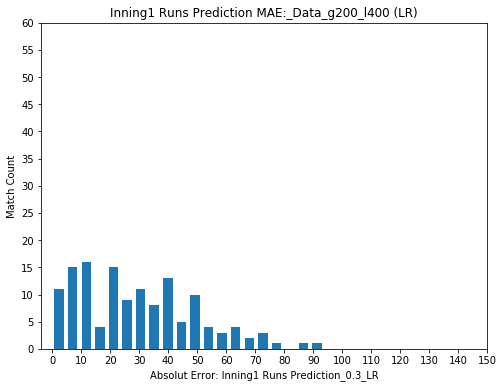

train:  1220 test: 136
ytrain min 201
ytrain max 399
MAE 30.475419050914986
RMSE 37.485857744627246


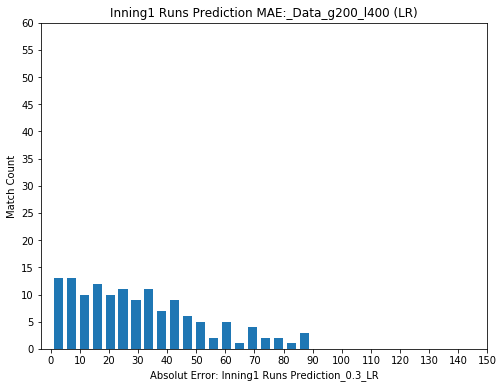

train:  1220 test: 136
ytrain min 201
ytrain max 399
MAE 33.73968998195395
RMSE 41.794230826001204


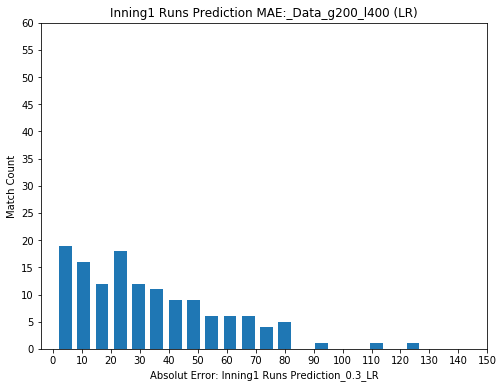

train:  1220 test: 136
ytrain min 201
ytrain max 399
MAE 36.50051297499744
RMSE 43.377178378055866


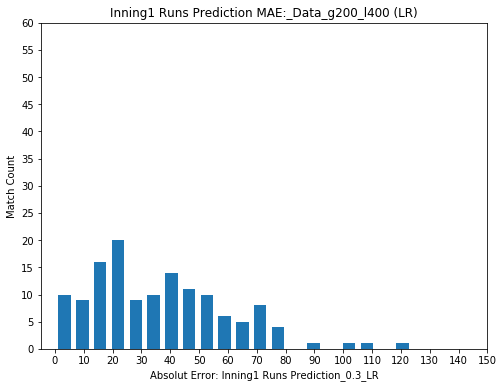

train:  1220 test: 136
ytrain min 201
ytrain max 399
MAE 34.43305937127981
RMSE 41.92622193576051


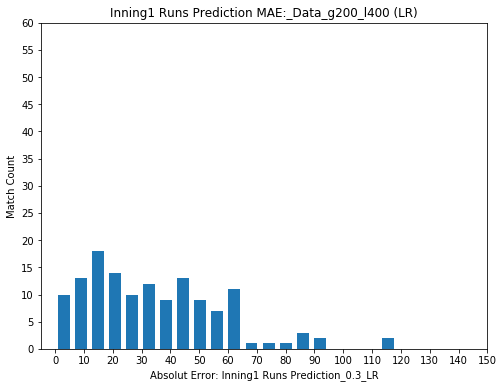

train:  1220 test: 136
ytrain min 201
ytrain max 399
MAE 31.820789343103904
RMSE 39.81499469719627


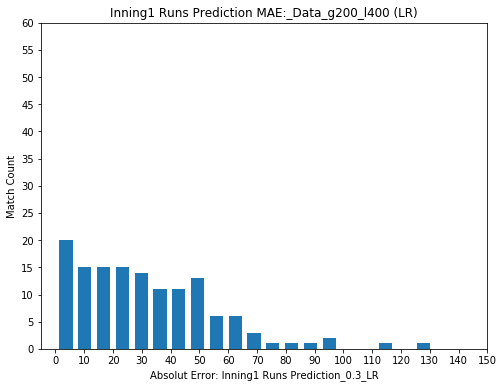

train:  1221 test: 135
ytrain min 201
ytrain max 399
MAE 34.499672382089564
RMSE 42.25939876334644


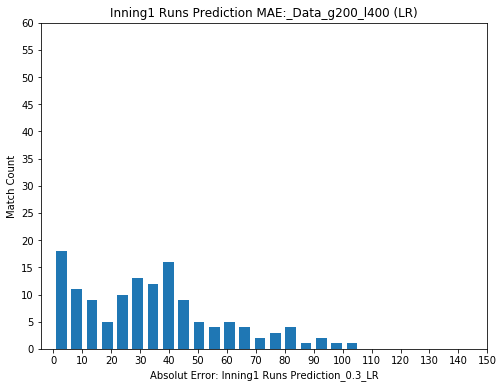

train:  1221 test: 135
ytrain min 201
ytrain max 399
MAE 38.1318491730556
RMSE 46.24929591414209


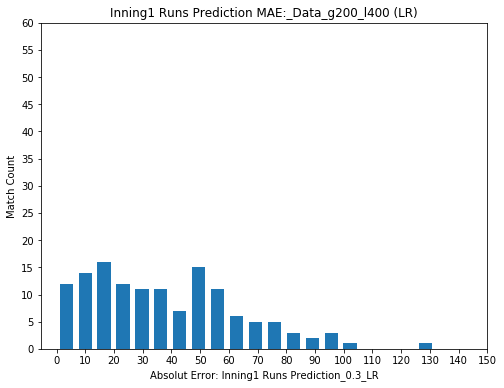

train:  1221 test: 135
ytrain min 201
ytrain max 399
MAE 36.47270860422991
RMSE 45.41494072895849


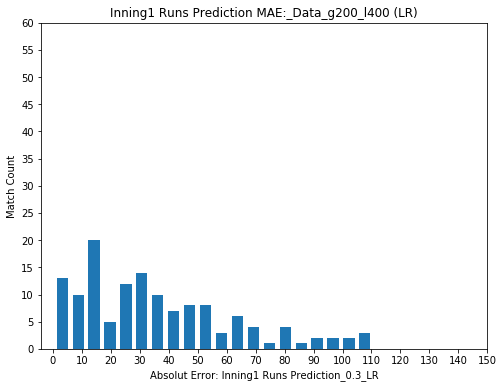

train:  1221 test: 135
ytrain min 201
ytrain max 399
MAE 41.23112284969125
RMSE 50.35565221013164


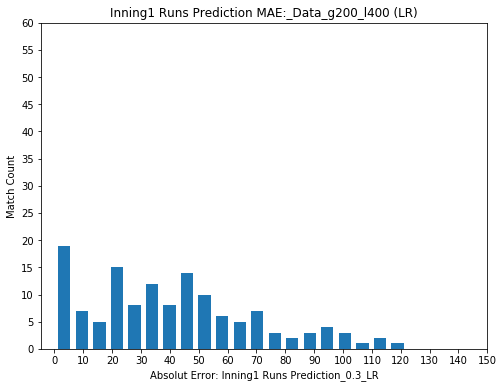

mean for all MAE: 34.689444954039956
median for all MAE: 34.46636587668469
mean for all RMSE: 42.46979397000754


In [217]:
from sklearn.linear_model import LinearRegression
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import KFold # import KFold


#inning1FeatureVectorComplete['inning1Runs'] = inning1FeatureVectorComplete['inning1Runs']**2
MAE_array=[]
RMSE_array=[]
MA_array=[]


runsTrans=1  #1/2
runsConvert=1 #2

X=inning1FeatureVector_trainTest
#print(X.columns)
kfolds= 10
kf = KFold(n_splits=kfolds) # Define the split - into 2 folds 
kf.get_n_splits(X) # returns the number of splitting iterations in the cross-validator
print(kf)


with PdfPages((str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjectionOver_"+str(inningsOver)+"_Regression_"+str(kfolds)+"fold_Data_"+str(dataConstraint)+"_LR.pdf")) as pdf:


    for train_index, test_index in kf.split(X):
        

        inning1FeatureVector_X, inning1FeatureVector_Y = X.iloc[train_index], X.iloc[test_index]

        #print(inning1FeatureVector_Y)
        #print(X.iloc[train_index[0]])
        ytrain, ytest = y.iloc[train_index], y.iloc[test_index]
        #print(ytrain)
        print('train: ',len(inning1FeatureVector_X),'test:',len(inning1FeatureVector_Y))
        
        print('ytrain min', ytrain.min())
        print('ytrain max', ytrain.max())
        #ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=tSize)


        reg = LinearRegression().fit(inning1FeatureVector_X, ytrain) #normalize=True
        #print(reg.score(inning1FeatureVector_X, ytrain))

        inning1FeatureVector_test = inning1FeatureVector_Y.copy()
        inning1FeatureVector_test['inning1Runs']=0
        inning1FeatureVector_test['inning1Runs'] = ytest#**runsConvert

        y_pred = reg.predict(inning1FeatureVector_Y)
        inning1FeatureVector_test['inning1RunsPred'] = y_pred #**runsConvert


        inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPred'])

        MAE_array.append(mean_absolute_error(ytest, y_pred))

    #   #MAE_array.append(mean_absolute_error(runs_test, runs_pred))
        print('MAE',mean_absolute_error(ytest, y_pred))
        print('RMSE',np.sqrt(mean_squared_error(ytest, y_pred)))
        RMSE_array.append(np.sqrt(mean_squared_error(ytest, y_pred)))
    #         RMSE_array.append(np.sqrt(mean_squared_error(runs_test, runs_pred)))


        inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjectionOver_"+str(inningsOver)+"_Regression_Data_"+str(dataConstraint)+"_"+str(tSize)+".csv")

        fig=plt.figure(figsize=(8,6))
        plt.hist(inning1FeatureVector_test['AbsError'], bins=20, rwidth=0.7)
        plt.yticks([0,5,10,15,20,25,30,35,40,45,50,55,60])
        plt.xticks([0,10,20,30,40,50,60,70,80,90,100,110,120,130,140,150])
        plt.xlabel("Absolut Error: Inning1 Runs Prediction_"+str(tSize)+"_LR")
        plt.ylabel("Match Count")
        plt.title("Inning1 Runs Prediction MAE:_Data_"+str(dataConstraint)+" (LR)")#g180, l400 
        plt.show()
        pdf.savefig(fig)


    #     #plt.savefig(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_Regression_g180_l400_"+str(tSize)+".pdf")
    print('mean for all MAE:', np.mean(MAE_array))
    print('median for all MAE:', np.median(MAE_array))
    #         print('median of median for all MAE:', np.median(MA_array))
    print('mean for all RMSE:', np.mean(RMSE_array))
   

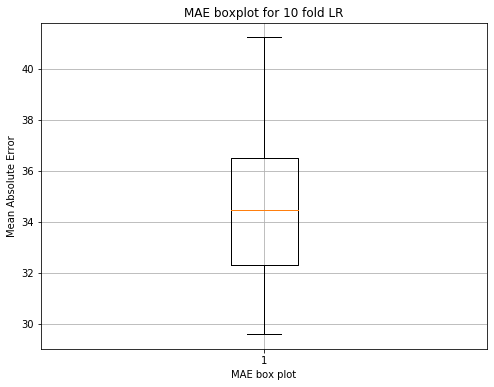

In [218]:
fig=plt.figure(figsize=(8,6))
plt.boxplot(MAE_array,meanline=True)
plt.title("MAE boxplot for "+str(kfolds)+" fold LR")
plt.xlabel("MAE box plot")
plt.ylabel("Mean Absolute Error")
plt.grid()
#plt.show()
plt.savefig((str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjection_Regression_"+str(kfolds)+"fold_Data_"+str(dataConstraint)+"_MAE_boxplot.pdf"))

## KNN with K-fold cross validation 

KFold(n_splits=10, random_state=None, shuffle=False)
K_neighbors 20
MAE 39.01898734177215
MAE med 33.0
RMSE :  48.393495221432765
MAE 38.87341772151899
MAE med 34.0
RMSE :  48.52247293519608
MAE 37.68354430379747
MAE med 33.0
RMSE :  47.35029707310602
MAE 42.36305732484077
MAE med 37.0
RMSE :  52.53818750677278
MAE 43.0
MAE med 39.0
RMSE :  52.83027746056715
MAE 38.12738853503185
MAE med 31.0
RMSE :  47.31881299963332
MAE 39.089171974522294
MAE med 34.0
RMSE :  48.26591681626539
MAE 41.52866242038217
MAE med 35.0
RMSE :  52.09141890529455
MAE 49.40764331210191
MAE med 44.0
RMSE :  59.597428662524635
MAE 49.394904458598724
MAE med 40.0
RMSE :  60.12020866934728
mean for all MAE: 41.84867773925664
median for all MAE: 40.30891719745223
mean for all RMSE: 51.702851625014


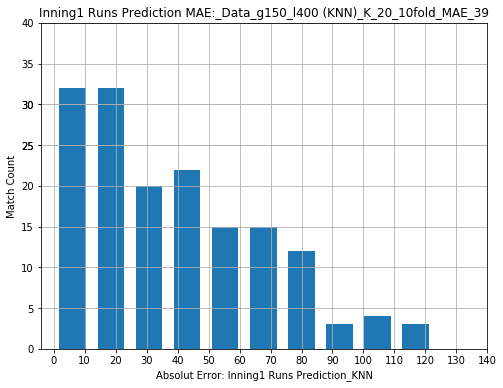

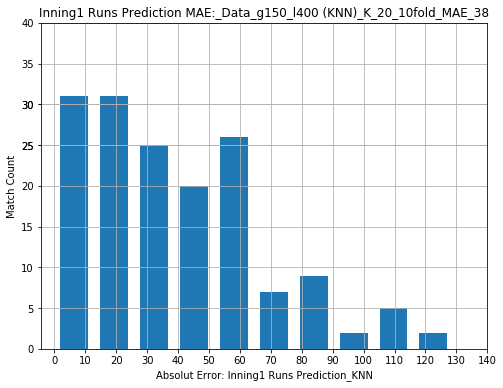

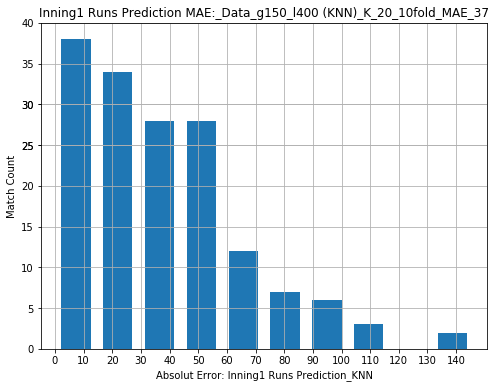

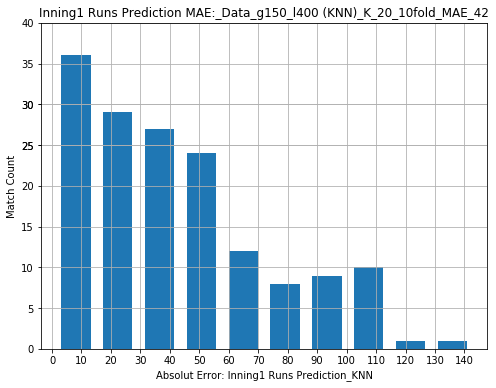

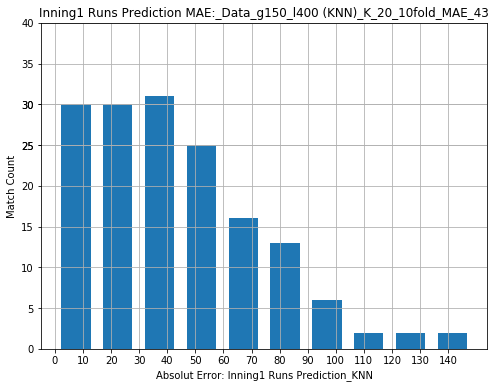

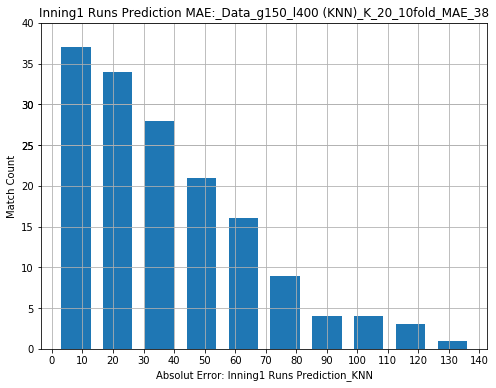

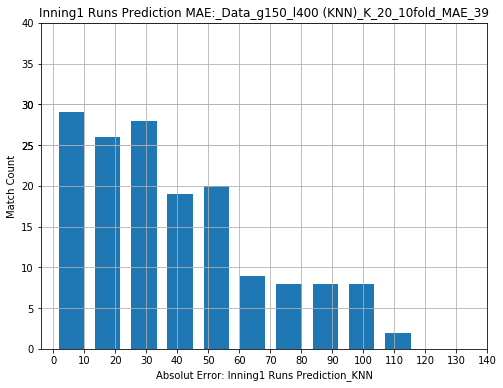

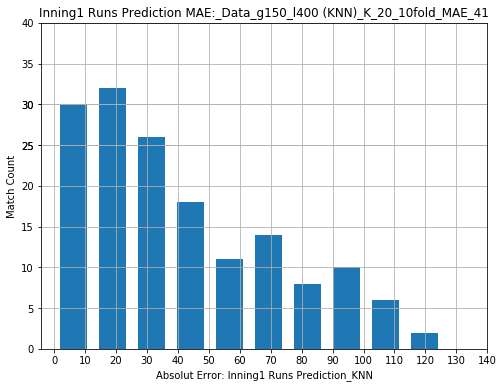

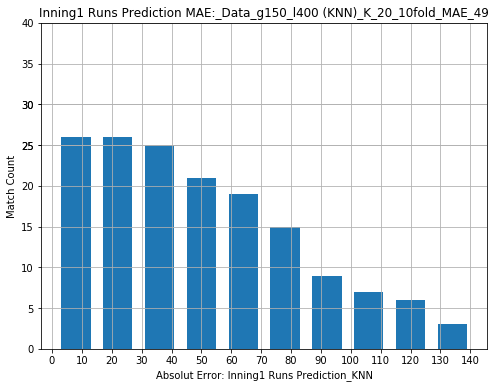

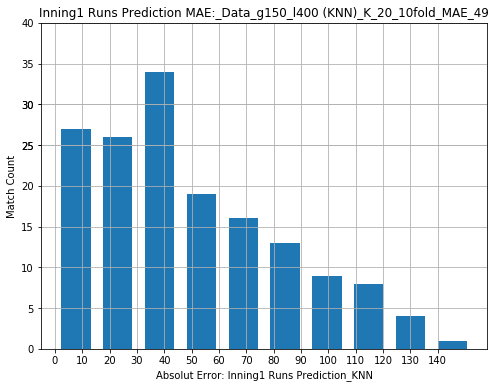

In [212]:
from sklearn.neighbors import NearestNeighbors
from sklearn.linear_model import LinearRegression
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import KFold # import KFold


MAE_array=[]
RMSE_array=[]
MA_array=[]



runsTrans=1  #1/2
runsConvert=1 #2
#inning1FeatureVectorComplete = inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - 1.5 * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + 1.5 * IQR))]

X=inning1FeatureVector_trainTest


kf = KFold(n_splits=kfolds) # Define the split - into 2 folds 
kf.get_n_splits(X) # returns the number of splitting iterations in the cross-validator
print(kf)



nbrs=[10,20,50,100]
K_neighbors=20
# for K_neighbors in nbrs:
    
print('K_neighbors', K_neighbors)
    


with PdfPages((str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjection_KNN_k"+str(K_neighbors)+"_"+str(kfolds)+"fold__Data_"+str(dataConstraint)+".pdf")) as pdf:


    for train_index, test_index in kf.split(X):
        

        inning1FeatureVector_X, inning1FeatureVector_Y = X.iloc[train_index], X.iloc[test_index]

        #print(inning1FeatureVector_Y)
        #print(X.iloc[train_index[0]])
        ytrain, ytest = y.iloc[train_index], y.iloc[test_index]
        #print(ytrain)
       # print('train: ',len(inning1FeatureVector_X),'test:',len(inning1FeatureVector_Y))
        #print(len(inning1FeatureVector_Y),len(ytest))

        #print('ytrain min', ytrain.min())
        #print('ytrain max', ytrain.max())
        
        
        
        inning1FeatureVector_train=pd.DataFrame()
        inning1FeatureVector_train = inning1FeatureVector_X.copy()

        inning1FeatureVector_train['inning1Runs']=0
        inning1FeatureVector_train['inning1Runs'] = ytrain

        inning1FeatureVector_test = inning1FeatureVector_Y.copy()
        inning1FeatureVector_test['inning1Runs']=0
        inning1FeatureVector_test['inning1Runs'] = ytest


         
        nbrs = NearestNeighbors(n_neighbors=K_neighbors, algorithm='ball_tree', metric='euclidean').fit(inning1FeatureVector_X) 
        
        distances, indices = nbrs.kneighbors(inning1FeatureVector_Y)
        #indices     

        inning1RunsPredicted=[]
        for i in range(len(inning1FeatureVector_Y)):
            runsScored=0
            runsPredArray=[]
            for k in range(K_neighbors):
                runsPredArray.append(inning1FeatureVector_train['inning1Runs'].iloc[indices[i][k]])
                #runsScored  = runsScored + inning1FeatureVector_train['inning1Runs'].iloc[indices[i][k]]
            inning1RunsPredicted.append(int(np.mean(runsPredArray)))   
            #inning1RunsPredicted.append(int(runsScored/5))

        #print('Length of predicted data:', len(inning1RunsPredicted))
        inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
        y_pred = inning1RunsPredicted

        inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])

        #print("MAE Median", inning1FeatureVector_test['AbsError'].median())
        
        print('MAE',inning1FeatureVector_test['AbsError'].mean())
        print('MAE med',inning1FeatureVector_test['AbsError'].median())
        #print('RMSE',np.sqrt(mean_squared_error(ytest, y_pred)))
        MAE_array.append(inning1FeatureVector_test['AbsError'].mean())
        MA_array.append(inning1FeatureVector_test['AbsError'].median())
        rmse=0
        for i in range(len(inning1FeatureVector_test)):
            rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

        maError = mean_absolute_error(ytest, inning1RunsPredicted)

        MA_array.append((maError))

        print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))
        RMSE_array.append(np.sqrt(rmse/len(inning1FeatureVector_test)))
    

        inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjection_KNN_K_"+str(K_neighbors)+"_Data_"+str(dataConstraint)+"_"+str(kfolds)+"Fold_MAE_"+str(int(mean_absolute_error(ytest, y_pred)))+".csv")
        
        inning1FeatureVector_test['AbsError'] = inning1FeatureVector_test['AbsError'].astype(int)
        fig=plt.figure(figsize=(8,6))
        plt.hist(inning1FeatureVector_test['AbsError'],  rwidth=0.7)#,bins=10) #bins=7,
        plt.yticks([0,5,10,15,20,25,30,25,30,35,40])
        plt.xticks([0,10,20,30,40,50,60,70,80,90,100,110,120,130,140])
        plt.xlabel("Absolut Error: Inning1 Runs Prediction_KNN")
        plt.ylabel("Match Count")
        plt.title("Inning1 Runs Prediction MAE:_Data_"+str(dataConstraint)+" (KNN)_K_"+str(K_neighbors)+"_"+str(kfolds)+"fold_MAE_"+str(int(mean_absolute_error(ytest, y_pred))))#g180, l400 
        #plt.show()
        plt.grid()
        pdf.savefig(fig)


    print('mean for all MAE:', np.mean(MAE_array))
    print('median for all MAE:', np.median(MAE_array))
    #         print('median of median for all MAE:', np.median(MA_array))
    print('mean for all RMSE:', np.mean(RMSE_array))
     

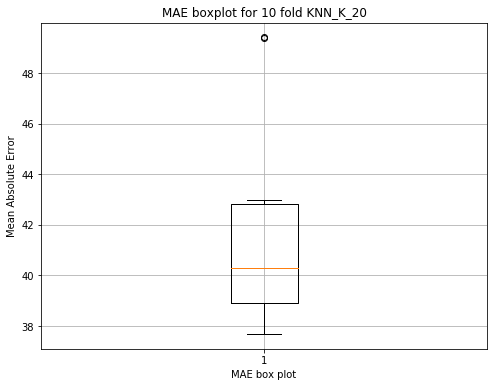

In [214]:
fig=plt.figure(figsize=(8,6))
plt.boxplot(MAE_array,meanline=True)
plt.title("MAE boxplot for "+str(kfolds)+" fold KNN_K_"+str(K_neighbors))
plt.xlabel("MAE box plot")
plt.ylabel("Mean Absolute Error")
plt.grid()
# plt.show()
plt.savefig((str(inning1BeforeStartProjectionResultFolder)+"innings1ScoresProjection_KNN_K_"+str(K_neighbors)+"_"+str(kfolds)+"fold_"+str(dataConstraint)+"_MAE_boxplot.pdf"))

## Ridge Regression 

In [26]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn import linear_model

#inning1FeatureVectorComplete = pd.read_csv(str(inning1BeforeStartProjectionFolder)+'startOfInning1Projection_playerClustCount_Complete1.csv')
print('current len', len(inning1FeatureVectorComplete))
#inning1FeatureVectorComplete = inning1FeatureVectorComplete[(inning1FeatureVectorComplete['inning1Runs']>150) & (inning1FeatureVectorComplete['inning1Runs']<450)]
print('newlength', len(inning1FeatureVectorComplete))
#inning1FeatureVectorComplete['inning1Runs'] = (inning1FeatureVectorComplete['inning1Runs'])**(1)
MAE_array=[]
RMSE_array=[]
toOrig = 1 #(1/3)

testingSize=[0.1,0.2,0.3]#[0.1,0.15,0.20,0.25,0.30]
#with PdfPages((str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_Regression_zScoreLess1.5_LR.pdf")) as pdf:
for tSize in testingSize:
    for i in range(100):

        #inning1FeatureVectorComplete = inning1FeatureVectorComplete[(inning1FeatureVectorComplete['inning1Runs']>=150) & (inning1FeatureVectorComplete['inning1Runs']<400)]

        y= inning1FeatureVectorComplete['inning1Runs']#**runsTrans
        inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','zScore',,'year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning1RunRate','inning2Runs','batsmenOfClust_4','bowlerOfClust_4','innings2Wickets','inning2RunRate'])]]#


        inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=tSize)

        reg = linear_model.Ridge(alpha=.5)

        reg.fit(inning1FeatureVector_X, ytrain)
        #print(reg.score(inning1FeatureVector_X, ytrain))

        inning1FeatureVector_test = inning1FeatureVector_Y.copy()
        inning1FeatureVector_test['inning1Runs']=0
        inning1FeatureVector_test['inning1Runs'] = ytest
        y_pred = reg.predict(inning1FeatureVector_Y)

        inning1FeatureVector_test['inning1RunsPred'] = y_pred

        maError = mean_absolute_error(ytest, y_pred)

        MAE_array.append((maError))

        RMSE_array.append(np.sqrt(mean_squared_error(ytest, y_pred)))

        #inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_Regression_powerLog10.csv")
        #print('mean for all MAE:', np.mean(MAE_array))
        #print('MAE',mean_absolute_error(ytest, y_pred))
        #print('RMSE',np.sqrt(mean_squared_error(ytest, y_pred)))
        #RMSE_array.append(np.sqrt(mean_squared_error(ytest, y_pred)))
    print('train data',len(ytrain),'test data',len(ytest))
    print('mean for all MAE:', np.mean(MAE_array))
    print('mean for all RMSE:', np.mean(RMSE_array))

current len 1472
newlength 1472
train data 1324 test data 148
mean for all MAE: 36.36467290689661
mean for all RMSE: 44.19115637593977
train data 1177 test data 295
mean for all MAE: 36.46340243161776
mean for all RMSE: 44.34829941302729
train data 1030 test data 442
mean for all MAE: 36.49511157556717
mean for all RMSE: 44.41164746625064


In [258]:
inning1FeatureVectorComplete['inning1Runs'].describe()

count    1574.000000
mean      258.714740
std        51.504701
min       150.000000
25%       223.000000
50%       257.500000
75%       294.000000
max       399.000000
Name: inning1Runs, dtype: float64

#  KNN


In [28]:
from sklearn.neighbors import NearestNeighbors

MAE_array=[]
MA_array=[]
RMSE_array=[]
#K_neighbors = 20
nbrs=[10,20,50,100]

for K_neighbors in nbrs:
    
    print('K_neighbors', K_neighbors)
    
    for i in range(100):

        #inning1FeatureVectorComplete =inning1FeatureVectorComplete[~((inning1FeatureVectorComplete['inning1Runs']) < (Q1 - 1.5 * IQR)) | ((inning1FeatureVectorComplete['inning1Runs']) > (Q3 + 1.5 * IQR))]
        
        #inning1FeatureVectorComplete = inning1FeatureVectorComplete[(inning1FeatureVectorComplete['inning1Runs']>=150) & (inning1FeatureVectorComplete['inning1Runs']<400)]


        y= inning1FeatureVectorComplete['inning1Runs']
        inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','team1c3','team2c3','year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','inning1RunRate','innings1Wickets','inning2Runs','inning2RunRate','innings2Wickets','batsmenOfClust_4','bowlerOfClust_4'])]]
        #print(inning1FeatureVector_trainTest.columns)
        #break
        #inning1FeatureVector_trainTest = inning1FeatureVectorComplete[['team1Cluster','team2Cluster']] 


        inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=0.20)
        #print(len(ytest))

        inning1FeatureVector_train=pd.DataFrame()
        inning1FeatureVector_train = inning1FeatureVector_X.copy()

        inning1FeatureVector_train['inning1Runs']=0
        inning1FeatureVector_train['inning1Runs'] = ytrain

        inning1FeatureVector_test = inning1FeatureVector_Y.copy()
        inning1FeatureVector_test['inning1Runs']=0
        inning1FeatureVector_test['inning1Runs'] = ytest


        X = inning1FeatureVector_X 
        nbrs = NearestNeighbors(n_neighbors=K_neighbors, algorithm='ball_tree', metric='euclidean').fit(X) 
        Y= inning1FeatureVector_Y   #np.array([[0,1],[3,4]])
        distances, indices = nbrs.kneighbors(Y)
        #indices     

        inning1RunsPredicted=[]
        for i in range(len(inning1FeatureVector_Y)):
            runsScored=0
            runsPredArray=[]
            for k in range(K_neighbors):
                runsPredArray.append(inning1FeatureVector_train['inning1Runs'].iloc[indices[i][k]])
                #runsScored  = runsScored + inning1FeatureVector_train['inning1Runs'].iloc[indices[i][k]]
            inning1RunsPredicted.append(int(np.mean(runsPredArray)))   
            #inning1RunsPredicted.append(int(runsScored/5))

        #print('Length of predicted data:', len(inning1RunsPredicted))
        inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
        inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])

        #print("MAE Median", inning1FeatureVector_test['AbsError'].median())
        MAE_array.append(inning1FeatureVector_test['AbsError'].mean())
        MA_array.append(inning1FeatureVector_test['AbsError'].median())
        rmse=0
        for i in range(len(inning1FeatureVector_test)):
            rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

        maError = mean_absolute_error(ytest, inning1RunsPredicted)

        MA_array.append((maError))

        #print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))
        RMSE_array.append(np.sqrt(rmse/len(inning1FeatureVector_test)))
    print(len(ytrain), len(ytest))

    print("Mean of Mean Abs Error:", np.mean(MAE_array))
    print("Median of Mean Abs Error:", np.mean(MA_array))
    print("Mean RMSE  Error:", np.mean(RMSE_array))

    #inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_20Test_KNN_"+str(K_neighbors)+"_with_home_euclidean_"+str(K_neighbors)+".csv")

K_neighbors 10
1177 295
Mean of Mean Abs Error: 36.837457627118646
Median of Mean Abs Error: 34.038728813559324
Mean RMSE  Error: 45.735695095454865
K_neighbors 20
1177 295
Mean of Mean Abs Error: 36.4571186440678
Median of Mean Abs Error: 33.7385593220339
Mean RMSE  Error: 45.16936066158642
K_neighbors 50
1177 295
Mean of Mean Abs Error: 36.379502824858754
Median of Mean Abs Error: 33.80975141242938
Mean RMSE  Error: 44.88638299809776
K_neighbors 100
1177 295
Mean of Mean Abs Error: 36.45934745762712
Median of Mean Abs Error: 34.08092372881356
Mean RMSE  Error: 44.77682739811462


In [273]:
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVC

from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)

 
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn import linear_model

#inning1FeatureVectorComplete = pd.read_csv(str(inning1BeforeStartProjectionFolder)+'startOfInning1Projection_playerClustCount_Complete1.csv')
print('current len', len(inning1FeatureVectorComplete))
#inning1FeatureVectorComplete = inning1FeatureVectorComplete[(inning1FeatureVectorComplete['inning1Runs']>150) & (inning1FeatureVectorComplete['inning1Runs']<450)]
print('newlength', len(inning1FeatureVectorComplete))
#inning1FeatureVectorComplete['inning1Runs'] = (inning1FeatureVectorComplete['inning1Runs'])**(1)
MAE_array=[]
RMSE_array=[]
toOrig = 1 #(1/3)

svc = SVC()
for i in range(1):
    
    #inning1FeatureVectorComplete = inning1FeatureVectorComplete[inning1FeatureVectorComplete['inning1Runs']>=130]
    y= inning1FeatureVectorComplete['inning1Runs']
    inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','team1c3','team2c3','year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning2Runs','innings2Wickets'])]]
    
    
   

    inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=0.20)
    #print(len(ytest))
    dtc = DecisionTreeClassifier(criterion='entropy',random_state=0)
    clf = BaggingClassifier(base_estimator=dtc, n_estimators=10, random_state=0)#.fit(X, y)
    
   # clf = DecisionTreeClassifier(criterion='entropy',random_state=0)
    #reg = linear_model.Ridge(alpha=.5)
   
    clf.fit(inning1FeatureVector_X, ytrain)
    #print(reg.score(inning1FeatureVector_X, ytrain))

    inning1FeatureVector_test = inning1FeatureVector_Y.copy()
    inning1FeatureVector_test['inning1Runs']=0
    inning1FeatureVector_test['inning1Runs'] = ytest
    y_pred = clf.predict(inning1FeatureVector_Y)
    
    inning1FeatureVector_test['inning1RunsPred'] = y_pred
    print(cross_val_score(clf,inning1FeatureVector_trainTest,y,cv = 5))

    maError = mean_absolute_error(ytest, y_pred)
   
    MAE_array.append((maError))
    
    RMSE_array.append(np.sqrt(mean_squared_error(ytest, y_pred)))
    
    #inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_Regression_powerLog10.csv")
    #
print('mean for all MAE:', np.mean(MAE_array))
print('mean for all RMSE:', np.mean(RMSE_array))

current len 1574
newlength 1574


c:\python\lib\site-packages\sklearn\model_selection\_split.py:657: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=5.
  % (min_groups, self.n_splits)), Warning)


[0.00238663 0.00819672 0.00318471 0.00760456 0.00943396]
mean for all MAE: 59.91746031746032
mean for all RMSE: 73.3021145670437


In [446]:
# from sklearn.ensemble import BaggingClassifier
# from sklearn.neighbors import KNeighborsClassifier
# from sklearn.neighbors import KNeighborsRegressor

# MAE_array=[]
# for i in range(10):


#     y= inning1FeatureVectorComplete['inning1Runs']


#     inning1FeatureVector_trainTest = inning1FeatureVectorComplete[inning1FeatureVectorComplete.columns[~inning1FeatureVectorComplete.columns.isin(['matchId','year','team1Cluster','team2Cluster','Continent','tossWinner','yearId','venueCountryCode','venueCountry','team1','team2','homeTeam','toss_winner_team','inning1Runs','innings1Wickets','inning2Runs','innings2Wickets'])]]
#     inning1FeatureVector_X,inning1FeatureVector_Y, ytrain,ytest = train_test_split(inning1FeatureVector_trainTest,y ,test_size=0.3)

#     inning1FeatureVector_train=pd.DataFrame()
#     inning1FeatureVector_train = inning1FeatureVector_X.copy()

#     inning1FeatureVector_train['inning1Runs']=0
#     inning1FeatureVector_train['inning1Runs'] = ytrain

#     inning1FeatureVector_test = inning1FeatureVector_Y.copy()
#     inning1FeatureVector_test['inning1Runs']=0
#     inning1FeatureVector_test['inning1Runs'] = ytest



#     Xtrain =inning1FeatureVector_X
#     #ytrain = y_train
#     #print(ytrain)

#     Xtest = inning1FeatureVector_Y
#     #ytest = y_test


#     neigh = KNeighborsRegressor(n_neighbors=150, weights='distance',metric='euclidean') #
#     neigh.fit(Xtrain, ytrain) 
#     Y_predicted = neigh.predict(Xtest)
#     #print(Y_predicted)
#     #print(neigh.score(Xtest, ytest))
#     inning1RunsPredicted= Y_predicted

#     #print(inning1RunsPredicted[0])    
#     #print('Length of predicted data:', len(inning1RunsPredicted))
#     inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
#     inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])
#     MAE_array.append(inning1FeatureVector_test['AbsError'].mean())
#     print("MAE", inning1FeatureVector_test['AbsError'].mean())
#     rmse=0
#     for i in range(len(inning1FeatureVector_test)):
#         rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

#     print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))

#     #inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_2011_12_KNN_k_with_home_tossWinner_VenueYear_manhattan_New"+str(K_neighbors)+".csv")
# print('mean for all iteration, MAE', np.mean(MAE_array))

In [298]:
def cegoricalFeaturesSim(trainData, testData,cat_ix):
    dist_result = np.zeros(len(trainData))
    for i in range(len(trainData)):
        dist_score=0
        for k in (cat_ix):
            dist_score = dist_score + np.not_equal(trainData[i][k], testData[k]) * 1 # use "* 1" to convert it into int
        dist_result[i]=round(dist_score/len(cat_ix),3)
    #print(sim_result)  
    return dist_result

In [299]:
#import math library 
from math import *
from decimal import Decimal 
from sklearn.metrics.pairwise import cosine_similarity

# Function distance between two points  
# and calculate distance value to given 
# root value(p is root value) 
def p_root(value, root):    
    root_value = 1 / float(root) 
    return round (Decimal(value) **Decimal(root_value), 3) 
def pRoot_distance(x, y, p_value):  
    # pass the p_root function to calculate 
    # all the value of vector parallely  
    return (p_root(sum(pow(abs(a-b), p_value)
            for a, b in zip(x, y)), p_value)) 


def numericalFeaturesSim(trainData, testData,cat_ix,distance_measure,p = 2):
    num_dist = np.zeros(len(trainData))
    #print(testData) 
    for i in range(len(trainData)):
        simScore=0
        tempTrain = np.zeros(len(trainData[i])-len(cat_ix))
        tempTest  = np.zeros(len(trainData[i])-len(cat_ix))
        j=0
        for k in range(len(trainData[0])):
            if(k not in (cat_ix)):
                #print(k)
                tempTrain[j] = trainData[i][j]
                tempTest[j]  = testData[j]
                j=j+1
                
        #print(tempTrain)
        if(distance_measure=='cosine'):
            tempTrain= tempTrain.reshape(1,len(trainData[i])-len(cat_ix))
            tempTest =tempTest.reshape(1,len(trainData[i])-len(cat_ix))
            coSim = cosine_similarity(tempTrain, tempTest) 
            num_dist[i]=round(1-coSim[0][0],3)
        else:
            dist = pRoot_distance(tempTrain, tempTest,p) # * 1 # use "* 1" to convert it into int
            num_dist[i]=round(dist/(p_root(len(tempTest),p)),3)
        #print(dist)
#         if(i==3):
#             break
        
        #num_dist[i]=round(dist/(p_root(len(tempTest),p)),3)
    #print(sim_result)  
    return num_dist

In [300]:
#inning1FeatureVector_test

In [54]:
print('test data', len(inning1FeatureVector_Y))
categorical_ix=[] #[0,1,2]
K_neighbors= 10#  len(inning1FeatureVector_X) #0
dist_measure = 'cosine'
inning1FeatureVector_train['simScore']=0
if(dist_measure=='cosine'):
    pValues=[1]
else:
    pValues=[0.5,1,2]
cat_weight =[0.05,0.3,0.7]#,0.3,0.5]

for w1 in cat_weight:
    for pVal in pValues:
        inning1RunsPredicted=[]
        
        for k in range(len(inning1FeatureVector_Y)):
            X_Matrix = []
            simScore_result=np.zeros(len(inning1FeatureVector_X))
            simScore_result1=[]
            for i in range(len(inning1FeatureVector_X)):
                X_Vect=[]
                for j in range(0,len(inning1FeatureVector_X.iloc[0])): 
                    #print(inning1FeatureVector_X.loc[i][0])
                    X_Vect.append(inning1FeatureVector_X.iloc[i][j])
                X_Matrix.append(X_Vect)
            #print(X_Matrix)
            Y_Matrix= inning1FeatureVector_Y.iloc[k] #inning1FeatureVector_Y   #np.array([[0,1],[3,4]])
            if(len(categorical_ix)==0):
                cat_dist=0
            else:
                cat_dist = cegoricalFeaturesSim(X_Matrix,Y_Matrix,categorical_ix)
            #print(Y_Matrix)
            num_dist = numericalFeaturesSim(X_Matrix,Y_Matrix,categorical_ix,dist_measure,pVal)
            #print(cat_sim)
            
#             for q in range(len(inning1FeatureVector_X)):
#                 simScore_result[q] = 1 - ((w1*cat_dist[q])+(1-(w1))*num_dist[q])
             
            simScore_result = num_dist
                
                
            #print(simScore_result)
            #print(simScore_result1)
#             for i in range(len(simScore_result)):
#                 inning1FeatureVector_train['simScore'].loc[i] = round(simScore_result[i],4)
            
            inning1FeatureVector_train['simScore'] = simScore_result
#             inning1FeatureVector_train['simScore'] = inning1FeatureVector_train['simScore'].astype(float)
            
            inning1FeatureVector_train['inning1Runs'] = inning1FeatureVector_train['inning1Runs'].astype(int)
            #inning1FeatureVector_train = inning1FeatureVector_train.sort(['simScore'], ascending=[0])
            inning1FeatureVector_train = inning1FeatureVector_train.sort_values(by='simScore', ascending=False) 
            #print(inning1FeatureVector_train['simScore'])
            runsPred=0            
            runsPredArray=[]
            simSum=0
            for m in range(K_neighbors): #K_neighbors
#                 runsPred = runsPred+ int(inning1FeatureVector_train['inning1Runs'].iloc[m])*float(inning1FeatureVector_train['simScore'].iloc[m])
#                 simSum = simSum+ float(inning1FeatureVector_train['simScore'].iloc[m])
#                 #print(simSum)
#                 #runsPred = 
#             if(simSum!=0):    
#                 runsPredArray.append(runsPred/simSum)
#             else:
#                 print('here')
#                 runsPredArray.append(runsPred)
#                 #print(runsPred)
                runsPredArray.append(inning1FeatureVector_train['inning1Runs'].iloc[m])
                
#                 #runsScored  = runsScored + inning1FeatureVector_train['inning1Runs'].iloc[indices[0][m]]
            #print('mean_w1'+str(w1)+'_pVal_'+str(pVal), int(np.mean(runsPredArray)))
            inning1RunsPredicted.append(int(np.mean(runsPredArray)))   


            #break
            #result,indices = neighbor.kneighbors(Y_Matrix.values.reshape(1, -1), n_neighbors = K_neighbors)
        
        print(inning1RunsPredicted)
        #print(inning1FeatureVector_test['inning1Runs'])
        print('mean_w1'+str(w1)+'_pVal_'+str(pVal))
        print('Length of predicted data:', len(inning1RunsPredicted))
        inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
        inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])
        print("MAE", inning1FeatureVector_test['AbsError'].mean())
        rmse=0
        for i in range(len(inning1FeatureVector_test)):
            rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

        print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))


test data 64
[264, 224, 219, 234, 240, 249, 207, 247, 208, 226, 215, 241, 271, 242, 227, 224, 251, 226, 236, 246, 259, 248, 268, 217, 274, 242, 258, 262, 263, 237, 248, 246, 274, 291, 249, 233, 265, 208, 244, 294, 256, 226, 241, 245, 290, 264, 276, 236, 261, 238, 249, 222, 263, 258, 234, 246, 223, 221, 232, 241, 250, 266, 259, 222]
mean_w10.05_pVal_1
Length of predicted data: 64
MAE 64.4375
RMSE :  79.24605668422878
[248, 252, 261, 256, 252, 240, 201, 279, 242, 276, 254, 257, 266, 251, 242, 259, 214, 249, 273, 250, 258, 256, 246, 227, 225, 227, 223, 219, 203, 243, 269, 252, 272, 235, 237, 244, 257, 290, 220, 222, 277, 276, 252, 234, 215, 279, 277, 227, 225, 241, 255, 271, 220, 273, 230, 243, 253, 235, 219, 287, 264, 221, 254, 243]
mean_w10.3_pVal_1
Length of predicted data: 64
MAE 62.15625
RMSE :  76.97483354967389
[237, 259, 236, 266, 221, 270, 237, 242, 205, 260, 222, 235, 259, 250, 207, 237, 254, 255, 269, 277, 232, 239, 221, 266, 233, 256, 228, 238, 251, 268, 254, 235, 227, 263, 26

In [ ]:
################## Lp distance

In [303]:
print('test data', len(inning1FeatureVector_Y))
categorical_ix=[0,1,2,3]
K_neighbors=10
dist_measure = 0
inning1FeatureVector_train['simScore']=0
if(dist_measure=='cosine'):
    pValues=[1]
else:
    pValues=[0.5,1,2]
cat_weight =[0.05,0.1,0.2,0.3,0.5]

for w1 in cat_weight:
    for pVal in pValues:
        inning1RunsPredicted=[]
        if(pVal==1):
            break
        simScore_Mat=[]
        for k in range(len(inning1FeatureVector_Y)):
            X_Matrix = []
            simScore_result=np.zeros(len(inning1FeatureVector_X))
            simScore_result1=[]
            for i in range(len(inning1FeatureVector_X)):
                X_Vect=[]
                for j in range(0,len(inning1FeatureVector_X.iloc[0])): 
                    #print(inning1FeatureVector_X.loc[i][0])
                    X_Vect.append(inning1FeatureVector_X.iloc[i][j])
                X_Matrix.append(X_Vect)
            #print(X_Matrix)
            Y_Matrix= inning1FeatureVector_Y.iloc[k] #inning1FeatureVector_Y   #np.array([[0,1],[3,4]])
            cat_dist = cegoricalFeaturesSim(X_Matrix,Y_Matrix,categorical_ix)
            #print(Y_Matrix)
            num_dist = numericalFeaturesSim(X_Matrix,Y_Matrix,categorical_ix,dist_measure,pVal)
            #print(cat_sim)
            
            for q in range(len(cat_dist)):
                simScore_result[q] = 1 - ((w1*cat_dist[q])+(1-(w1))*num_dist[q])
                
            
            #simScore_Mat.append(simScore_result)
            
#             fig = px.scatter(x=simScore_result, y=simScore_result)
#             fig.show()
            #print(simScore_result)
            #print(simScore_result1)
#             for i in range(len(simScore_result)):
#                 inning1FeatureVector_train['simScore'].loc[i] = round(simScore_result[i],4)
            
            inning1FeatureVector_train['simScore'] = simScore_result
#             inning1FeatureVector_train['simScore'] = inning1FeatureVector_train['simScore'].astype(float)
            
            inning1FeatureVector_train['inning1Runs'] = inning1FeatureVector_train['inning1Runs'].astype(int)
            #inning1FeatureVector_train = inning1FeatureVector_train.sort(['simScore'], ascending=[0])
            inning1FeatureVector_train = inning1FeatureVector_train.sort_values(by='simScore', ascending=False) 
            #print(inning1FeatureVector_train['simScore'])
            runsPred=0            
            runsPredArray=[]
            simSum=0
            for m in range(K_neighbors): #K_neighbors
#                 runsPred = runsPred+ int(inning1FeatureVector_train['inning1Runs'].iloc[m])*float(inning1FeatureVector_train['simScore'].iloc[m])
#                 simSum = simSum+ float(inning1FeatureVector_train['simScore'].iloc[m])
#                 #print(simSum)
#                 #runsPred = 
#             if(simSum!=0):    
#                 runsPredArray.append(runsPred/simSum)
#             else:
#                 print('here')
#                 runsPredArray.append(runsPred)
                runsPredArray.append(int(inning1FeatureVector_train['inning1Runs'].iloc[m]))
                #print(runsPred)
                #print(inning1FeatureVector_train['simScore'].iloc[m])
                
#                 #runsScored  = runsScored + inning1FeatureVector_train['inning1Runs'].iloc[indices[0][m]]
            #print('mean_w1'+str(w1)+'_pVal_'+str(pVal), int(np.mean(runsPredArray)))
            inning1RunsPredicted.append(int(np.mean(runsPredArray)))   


            #break
            #result,indices = neighbor.kneighbors(Y_Matrix.values.reshape(1, -1), n_neighbors = K_neighbors)
        
        print(inning1RunsPredicted)
        #print(inning1FeatureVector_test['inning1Runs'])
        print('mean_w1'+str(w1)+'_pVal_'+str(pVal))
        print('Length of predicted data:', len(inning1RunsPredicted))
        inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
        inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])
        print("MAE", inning1FeatureVector_test['AbsError'].mean())
        rmse=0
        for i in range(len(inning1FeatureVector_test)):
            rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

        print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))


test data 64
[254, 249, 233, 231, 250, 220, 227, 223, 209, 275, 238, 205, 241, 215, 209, 249, 243, 227, 249, 259, 260, 251, 229, 253, 268, 245, 243, 257, 234, 250, 226, 235, 252, 254, 254, 233, 210, 271, 215, 253, 245, 271, 234, 233, 251, 231, 227, 237, 245, 257, 256, 244, 266, 274, 233, 218, 238, 204, 234, 223, 225, 238, 263, 253]
mean_w10.05_pVal_0.5
Length of predicted data: 64
MAE 55.828125
RMSE :  68.66733666744328
[246, 263, 236, 235, 216, 278, 275, 231, 262, 244, 250, 272, 228, 303, 251, 219, 324, 244, 246, 270, 199, 254, 222, 260, 253, 279, 249, 249, 256, 243, 299, 228, 230, 250, 248, 192, 276, 246, 235, 248, 230, 247, 269, 266, 252, 237, 246, 287, 260, 247, 257, 264, 287, 256, 223, 261, 252, 238, 269, 212, 267, 246, 234, 242]
mean_w10.1_pVal_0.5
Length of predicted data: 64
MAE 54.5625
RMSE :  67.57195239150634
[212, 237, 230, 257, 258, 248, 210, 251, 223, 266, 235, 256, 252, 246, 214, 239, 254, 273, 215, 262, 199, 255, 262, 262, 264, 253, 212, 254, 228, 259, 254, 264, 190, 25

In [ ]:
#inning1FeatureVector_test['inning1Runs'].iloc[0]
inning1FeatureVector_test#['simScore'].loc[3]

In [449]:
from sklearn.neighbors import NearestNeighbors
categorical_ix=[0,1,2]
nan_eqv=0

pred_indices =[]
K_neighbors=10
inning1RunsPredicted=[]
print('test data', len(inning1FeatureVector_Y))
for k in range(len(inning1FeatureVector_Y)):

    X_Matrix = []
    for i in range(len(inning1FeatureVector_X)):
        X_Vect=[]
        
        #if((int(inning1FeatureVector_X.iloc[i][0]) == int(inning1FeatureVector_Y.iloc[k][0])) and (int(inning1FeatureVector_X.iloc[i][1]) == int(inning1FeatureVector_Y.iloc[k][1]))): 
        for j in range(0,len(inning1FeatureVector_X.iloc[0])): 
            #print(inning1FeatureVector_X.loc[i][0])
            X_Vect.append(inning1FeatureVector_X.iloc[i][j])
        X_Matrix.append(X_Vect)
    #print(np.array(X_Matrix).shape)
    
    # Declare the HEOM with a correct NaN equivalent value
    heom_metric = HEOM(np.array(X_Matrix), categorical_ix, nan_equivalents = [nan_eqv])

    # Declare NearestNeighbor and link the metric
    neighbor = NearestNeighbors(metric = 'euclidean')

    # Fit the model which uses the custom distance metric 
    neighbor.fit(np.array(X_Matrix))

    #nbrs = NearestNeighbors(n_neighbors=K_neighbors, algorithm='ball_tree', metric='euclidean').fit(np.array(X_Matrix))
    
    Y_Matrix= inning1FeatureVector_Y.iloc[k] #inning1FeatureVector_Y   #np.array([[0,1],[3,4]])
    #print(np.array(Y_Matrix).shape)
    #print()
    result,indices = neighbor.kneighbors(Y_Matrix.values.reshape(1, -1), n_neighbors = K_neighbors)
    #print(result)
    #distances, indices = nbrs.kneighbors(Y_Matrix.values.reshape(1,-1))
    #pred_indices.append(np.array(indices))
    
    runsScored=0
    runsPredArray=[]
    for m in range(K_neighbors):
        runsPredArray.append(inning1FeatureVector_train['inning1Runs'].iloc[indices[0][m]])
        #runsScored  = runsScored + inning1FeatureVector_train['inning1Runs'].iloc[indices[0][m]]
    inning1RunsPredicted.append(int(np.mean(runsPredArray)))   
    
# #print(pred_indices)
# #indices = pred_indices
# print(inning1RunsPredicted)


print(inning1RunsPredicted[0])    
print('Length of predicted data:', len(inning1RunsPredicted))
inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])
print("MAE", inning1FeatureVector_test['AbsError'].mean())
rmse=0
for i in range(len(inning1FeatureVector_test)):
    rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))

#inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_2018_KNN_k_with_home_tossWinner_VenueYear_manhattan_New"+str(K_neighbors)+".csv")

In [450]:
from sklearn.neighbors import NearestNeighbors
K_neighbors = 5
X = inning1FeatureVector_X 
nbrs = NearestNeighbors(n_neighbors=K_neighbors, algorithm='ball_tree', metric='euclidean').fit(X) 
Y= inning1FeatureVector_Y   #np.array([[0,1],[3,4]])
distances, indices = nbrs.kneighbors(Y)
#indices     

inning1RunsPredicted=[]
for i in range(len(inning1FeatureVector_Y)):
    runsScored=0
    runsPredArray=[]
    for k in range(K_neighbors):
        runsPredArray.append(inning1FeatureVector_train['inning1Runs'].iloc[indices[i][k]])
        #runsScored  = runsScored + inning1FeatureVector_train['inning1Runs'].iloc[indices[i][k]]
    inning1RunsPredicted.append(int(np.mean(runsPredArray)))   
    #inning1RunsPredicted.append(int(runsScored/5))
    
print('Length of predicted data:', len(inning1RunsPredicted))
inning1FeatureVector_test['inning1RunsPredicted'] = inning1RunsPredicted
inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning1Runs'] - inning1FeatureVector_test['inning1RunsPredicted'])

print("MAE", inning1FeatureVector_test['AbsError'].mean())
rmse=0
for i in range(len(inning1FeatureVector_test)):
    rmse = rmse + ( (inning1FeatureVector_test['inning1Runs'].iloc[i] - inning1FeatureVector_test['inning1RunsPredicted'].iloc[i])**2)

print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))
#inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings1ScoresProjection_2011_12_KNN_k_with_home_tossWinner_VenueYear_euclidean_"+str(K_neighbors)+".csv")

Length of predicted data: 14
MAE 62.92857142857143
RMSE :  82.1266443627506


In [454]:
# from sklearn.neighbors import KDTree
# K_neighbors=10
# #X = np.array([[-1, -1], [-2, -1], [-3, -2], [1, 1], [2, 1], [3, 2]])
# kdt = KDTree(X, leaf_size=30, metric='manhattan')
# indices =kdt.query(X, k=K_neighbors, return_distance=False)   

# Inning2 

In [467]:
allMatchSummary = pd.read_csv('C:/python/Scripts/JupyterNotebooks/matchSummary/allODIMatchesSummary_DetailInfo_2001_2019.csv', sep=',')

#allMatchSummary.drop(['Unnamed: 0'], axis=1, inplace=True)

allMatchSummary.year.unique()

array([2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019], dtype=int64)

In [ ]:
#matchSummariesLocation =  'C:/python/All_ODIs_2001_19_top10Teams/' #'F:/LUMS/Cricket Data/Data Files/All ODIs/'

matchSummariesLocation= 'D:/F_Drive/LUMS/Cricket Data/Data Files/All ODIs/'

list_of_files = os.listdir(matchSummariesLocation)


matchRecordFile = open(str(inning1BeforeStartProjectionFolder)+'startOfInng2_team2Features_2001_19.csv','w')

matchRecordFile.write('matchId,year,venueCountry,team1,team2,homeTeam,toss_winner_team,inning1Runs,innings1Wickets,inning2Runs,innings2Wickets,')
for i in range(11):
    matchRecordFile.write('batsman,')
for i in range(11):
    if(i==10):
        matchRecordFile.write('bowler')
    else:
        matchRecordFile.write('bowler,')
           
matchRecordFile.write('\n')


teamName =  ['England','Australia','South Africa','West Indies','New Zealand','India','Pakistan','Sri Lanka','Zimbabwe','Bangladesh']

filter1 =  allMatchSummary['team1'].isin(teamName)
filter2 =  allMatchSummary['team2'].isin(teamName)
filter3 =  allMatchSummary['rain_rule']!=1
filter4 =  allMatchSummary['winnerTeam']!='tied'
filter5 =  allMatchSummary['winnerTeam']!='no result'
matchSummariesFiltered = allMatchSummary[filter1 & filter2 & filter3 & filter4 & filter5]
print('matchesCount', len(matchSummariesFiltered))
matchCount=0
for matchId in matchSummariesFiltered['matchId']:
    matchCount=matchCount+1
    #if(matchCount==4):
    #    break
    for matchFile in list_of_files:
        try:
            matchIdinFile = matchFile.split('_')[0]
            
            if(matchIdinFile.find("new")>=0):
                fileMatchId = matchIdinFile[3:]
            else:
                fileMatchId= matchIdinFile           
            
            #print(fileMatchId)
            if str(matchId)==str(fileMatchId):# matchIdinFile.contains(str(matchId)):
                
                data_file = open(matchSummariesLocation+str(matchFile))
                #print(data_file)
                data = json.load(data_file)
                
                matchdata = matchSummariesFiltered[matchSummariesFiltered['matchId']==int(matchId)].iloc[0]
                #print(matchdata['team1'])
                #print(matchdata['team1']+ '  '+ matchdata['team2'])
                matchRecordFile.write(str(matchdata['matchId']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['year']))
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['country_name'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['team1'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['team2'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['home_team'])
                matchRecordFile.write(',')
                matchRecordFile.write(matchdata['toss_winner_team'])
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings1Runs']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings1Wickets']))
                matchRecordFile.write(',')

                matchRecordFile.write(str(matchdata['innings2Runs']))
                matchRecordFile.write(',')
                matchRecordFile.write(str(matchdata['innings2Wickets']))
                matchRecordFile.write(',')

               
                #matchRecordFile.write(str(matchId)+',')
                for i in range(11):      
                    matchRecordFile.write(str(data['teams']['t2']['p'][int(i)]['id'])+',')
                for i in range(11):
                    if(i==10):
                        matchRecordFile.write(str(data['teams']['t1']['p'][int(i)]['id']))
                    else:
                        matchRecordFile.write(str(data['teams']['t1']['p'][int(i)]['id'])+',')
                matchRecordFile.write('\n')
        except:
            print(matchFile)
matchRecordFile.close()

matchesCount 1731
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
108978

64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
652

249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369

760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457

64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
649

247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385

66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
7

433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800

1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239


661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
67

350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626

426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033

530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533

1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380


656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302


345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276

1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500


64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
649

657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66

366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570

919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520

530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535

578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
6

66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
73

403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222

1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515


65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66

319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024

456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
10

64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
656

256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801

860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259

587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64

235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744

710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121

567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
6

1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
22301

66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
66789

374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582

1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026


656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309

377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590

1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278


65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66

300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456

385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962

636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
6

247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230

750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629

536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
647

226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742

66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943


422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249

1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636


65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
6

386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966

1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923


64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421


267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147

914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568

643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64

1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393

736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731

351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219

903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148

433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782

1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499


64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64

64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64

238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755

667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671

521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656

1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146


65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66

297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341

434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034

64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
65644

249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481

770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993

567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
6478

225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506

667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669

433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168

1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733

66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690

351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219

1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472


64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646

214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466

65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66

350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285

434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
104

623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64

1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
22638

64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
65643

643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879


247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390

742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049

523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161

1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
23

66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443

422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250

1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986


65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66

323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531

461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1

64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
656

257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806

870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142

597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839

209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511

251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914

812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403

562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749

1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496


64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
652

1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
23990

238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757

366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569

1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004


65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
6576

293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046

406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847


64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
650

247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755

750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849

540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
647

1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512


64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
6

247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389

749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231

534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712


209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918

66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
7

415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967

1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245


656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
6

325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073

446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816

1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067


65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300

267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570

730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843

560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
6

1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499


65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66

66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767


249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785

749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779

530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535

1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
2

66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919


251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906

66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455


446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816

1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
21

65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
66772

366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571

1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009


65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66

319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024

426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
10

64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
6565

247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757

750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853

386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965

936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1

64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
649

256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804

754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861

446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925

566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
6

64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
649

64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
64

66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
73

410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039

1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720


65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293


325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568

467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083

64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
649

65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66

314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758

455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314

64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
652

1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226

65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
6

64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
65

239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007

66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
71029

293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048

259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994

251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793

667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667

291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901

1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275


566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
6476

223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493

66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
7497

433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796

1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509


65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66

350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240

1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290


64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
656

225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502

65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342

343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173

1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210


64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
649

64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
6564

247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471

66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443


415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208

1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922


64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
649

249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789

667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663

335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621

65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
66169

66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
7103

390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154

1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168


65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66

299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059

439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299


64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
656

250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566

745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215

426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
10333

754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867

430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430

1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213

64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435

251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915

66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795


433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800

1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
22639

217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478

66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681


446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815

335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382

345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276

1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500


64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
65

212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462

656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
663

250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587

66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736

65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807

65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300

66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
73

567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
6478

256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797

259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487

295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478

474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371

1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
2162

656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66

335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622

439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497

567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64

1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069


66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897

424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733

1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025


65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794

296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685

423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
10298

64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
652

238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672

291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901

217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480

434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369


64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
649

535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
64

1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240


247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382

743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659

433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797

647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64

247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475

742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645

366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569

913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665

643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
6487

212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463

65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66

291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201

319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023

770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192

656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66

65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66

299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061

441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301

64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
656

250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586

792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196

426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
10

636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64

65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793

267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144

361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560

914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143

433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930

1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241


65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66

64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
649

64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
65649

64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
649

211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459

238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492

267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580

919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522

647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64

1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244


64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435

267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144

913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666

643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878

239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612

65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66

313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755

902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959

635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856

1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238

1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523


64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
649

300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460

446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059

64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
656

250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687

800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384

573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64

226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231

667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749

392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471

567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
6

215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471

238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492

291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901

325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251

366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578

415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207

403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223

1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733

64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646

273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800

760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339

1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777


64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656

267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147

914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568

643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64

238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669

259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441

749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609

489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018

64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
656

256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796

727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623

415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962

560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
6474

65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901

661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
67

375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587

1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639


566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
6476

1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
2162

65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906

66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083

750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629

335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383

997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
102

64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
6

1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020


64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
6565

267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579

352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888

314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758

534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643

208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916

66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
73

415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965

1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244


656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309

325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620

903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152

409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027

1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986


65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66

297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043

361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565

514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619

1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694


64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
649

503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616

291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204

745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215

578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64

226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238

676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761

446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814

1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694


225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827

667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673

433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170

1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
21

65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66

249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361

66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
74

433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231

1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986


64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
652

214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469

65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66

256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805

323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530

255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798

1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803


64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
6564

267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568

914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529

64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64

211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457

65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
6571

259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994

913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233

636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
6

1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
2399

257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806

313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693351693_Australia_New Zealand_2_2009.json
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
3

750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633

410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036

1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025


564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
6

1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556

64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
656

226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214

656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302


264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581

792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196

571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
6478

225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204

667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675

433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656

1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
21182

65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
6

352665_England_West Indies_2_2009.json
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
42

1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323


64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
6566

291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759

936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1

64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
649

247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706

736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641

433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927

518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925

562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
6474

602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
6484

1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695


64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
656

410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039

1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720


65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293


325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568

467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083

64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637

258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007

894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150

602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
6484

1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236

249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363

225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827

65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
6

249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504

298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626

296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669

297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047

351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849

1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246


223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494

66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749

433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797

1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512


65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66

350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241

1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777


997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022

535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
64

211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361

66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623


377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588

1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501


65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789

335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380

1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605


65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807

430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983

1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492


64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095

1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215

64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
6563

258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426

710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297

317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275

390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923

1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170


64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
6563

236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746

66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
7

378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594

936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020

463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945

1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607


578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
648

1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
22423

64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407


226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232

249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345

360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559

1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281


1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240


65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66

350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627

1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283


64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493

289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357

727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645

351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217

1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537


64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423

656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
6632

300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315

415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958

456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
10

538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729


573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
6479

1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843


64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
65

258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437

902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958

635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856

238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469

66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443


291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734

860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260

587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
648

221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488

249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361

297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047

895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827

422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249

1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538


645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
648

1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512


1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225

249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220

754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137

562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
6474

217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482

66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
74

433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210

1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988


212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462

66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943


422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249

486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089

531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635

1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067


64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421


247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385

65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66

267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581

350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237

343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172

518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985

1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393

66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722

390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468

1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491


65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66

300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313

913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235

385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606

463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249


474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369

1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005


587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
6

1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
2

221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487

656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
663

293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042

298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711

291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202

319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749

997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022

64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
649

247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777

750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635

538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729


213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465

66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
7439

424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733

1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693


656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
663

313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756

392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470

521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657

645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885

64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
652

1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366

1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251


66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919


392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471

1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496


65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66

300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316

452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
106873

64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
656

251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914

812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403

573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
647

64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
652

1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
23817

1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929


64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
6564

225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827

1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019


1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023


1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728


64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
649

247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392

291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733

350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286

452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
106873

474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015

226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743

1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239

66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
6

64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447

385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604

1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
2

226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238

259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488

903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151

636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864


238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492

730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209

514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619

1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
22636

452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
10687

685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787

474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372

1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556

1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171


1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031


754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159

426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
10314

64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
652

1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393

65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
6571

65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66

65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66

247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754

1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239


64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
6565

225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502

65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
6616

247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390

1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244


66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730

267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556

297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045

434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
104

522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161

1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012


645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
6488

209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777

1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523


64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656

64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
6565

65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645

656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310


656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326


66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
73008

656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66

868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262

377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588

1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029


1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
21659

65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66

667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671

360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558

403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214

997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
10

426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
10333

433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984

433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230

1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208


489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026

1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017


754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143

1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005


64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64

217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477

66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
7

656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309

66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
7

293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348

736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959

298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625

903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151

518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929

64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
64

582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823

1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250


455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075

913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233

474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372

1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
22423

656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285


676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761

65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802

64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409

531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669

522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159

1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844


1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
22636

1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
2381

1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
22

456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
107866

64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
649

226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230

226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231

656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333

66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
7

380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600

523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162

1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238

226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213

656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
6

247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386

66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437


690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793

291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901

754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867

66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
74

293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048

452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
10687

567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64

64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
649

1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
23722

211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459

217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483

226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240

65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727


667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673

296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692

226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378

66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
74261

65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66

750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849

433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231

64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
649

236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746

236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747

657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66

293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042

247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066

710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293

66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
74977

267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569

251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915

667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675

656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66

65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902

66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
72234

257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807

885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143

66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
7103

249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483

770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993

463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945

433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071

426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015

1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035


571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790

1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834


1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321


456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1

810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389

564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
6475

351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722

1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474


64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
652

65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66

65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
6571

238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489

66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
7

259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993

743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623

754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167

408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025

516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472

408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363

1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497


919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520

518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928

1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568

66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291

730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843

514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622

1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248


452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
107

565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
647

1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840


64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467


226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232

239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769

66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
66789

66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
73644

736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729

667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665

997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
102

565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
6

223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491

66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919


750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853

390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468

936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
10

518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474

587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64

1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842


64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
656

209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510

225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505

1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243


1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728


1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148


64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423

256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804

264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670

924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
100

730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847

473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360

538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64

64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
649

1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209

1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213

225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204

1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
2263

1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539


225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205

66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
72

742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599

406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
10273

573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
647

636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64

1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245


64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
650

216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473

247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706

1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844


1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739


439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050

730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275

914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884

64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64

240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465

66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305


264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578

913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235

636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
648

238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016

249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219

66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919


267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146

1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546


64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481

249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220

66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339

264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580

439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
10502

64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
652

446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923

264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134

225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204

66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730

643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878

534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639

1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515


1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797


750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849

540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735

215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470

656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
663

247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392

249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360

931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373

64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093


247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472

895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827

403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223

267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576

249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361

667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731

667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665

463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250

64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
649

64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
649

1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375


65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
6566

238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754

66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
74

792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204

65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
66764

249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365

1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246


770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192

65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657

361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567

249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275756_Bangladesh_Zimbabwe_2_2007.json
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
29

1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721


66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
74515

474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146

251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914

1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831


212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463

1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171


1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636


64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
650

211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458

65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66

247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385

1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905


1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
23819

1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757


64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640

247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070

247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381

66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722

727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833

343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172

868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263

433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216

387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153

997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
10

913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666

66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
69

668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753

291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471

770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965

64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
650

317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759

1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637


710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295

66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
7497

295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480

247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069

750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629

65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66

64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656

247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384

1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842


65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657

247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779

66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
7

690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791

885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147

66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287


289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355

736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727

354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890

932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
10199

565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64

433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782

293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043

754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163

736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815

66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
7

65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
6595

258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010

314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758

300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460

894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148

566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774


225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501

65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66

249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220

291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902

293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044

760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339

406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
10

426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
10333

1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540


64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
656

65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
6566

225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503

66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449


291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633

742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593

335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373

439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
104049

643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
6

238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470

225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501

247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389

239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008

1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091


656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347


297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046

754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143

343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275

800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793

800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384

434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371

467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
108

1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546


423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
103

736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287

760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461

65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66

247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378

66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
74

298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623

750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629

936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
101

64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
649

247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384

66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
7

317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716

924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
100088

473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360

1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777


540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
647

1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843


1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
23

239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665

237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753

1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669

66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
7223

298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627

325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619

868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262

446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
10

64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
652

65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66

297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756

868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263

903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149

743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625

64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
6

351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722

1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278


1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209

1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491


589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832


415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961

416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219

1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147


1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924


1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605


924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
100088

420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221

1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777


1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728


913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567

66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795


325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533

914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568

902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147

433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168

238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481

66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979

66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668

366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571

236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748

66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
6689

291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202

335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622

296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690

749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615

1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215

64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
656

225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504

66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
7

267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146

710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123

293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042

997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022

64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
649

247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777

744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207

335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382

936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017


433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984

1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547


531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667

385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606

238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495

247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389

667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665

914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569

645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
6488

247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713

710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469

736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959

319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751

461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
107

1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494


1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226

64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646

237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750

685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789

296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693

810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390

65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66

350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626

1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031


65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801

296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691

426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
103142

239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770

293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045

997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
10

64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
649

335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624

361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561

1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
2132

65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66

274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347

361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562

247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715

456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
107866

64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
65643

251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908

211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360

66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
7103

736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965

377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588

467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183


566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774


1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242


64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
656

65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
6571

226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378

65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66

65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645

249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688

247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715

1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252


685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787

65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803

247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755

366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569

423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
103

433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170

1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315


1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
22638

217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483

209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511

213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464

1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
2

1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
22

249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071

66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455


415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968

1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246


1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539


225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203

256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801

1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
23722

66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
7279

366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572

299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061

377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588

238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754

710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293

433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781

1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148


635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857


349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282

291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732

426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673

426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
10

560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743


65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
65

293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049

406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
102685

433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442

247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385

66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
73643

383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601

211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458

313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755

1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170


64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
656

343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162

1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806


65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803

361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560

1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842


65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
6595

403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217

1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239

65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66

65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904

403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215

1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508


65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66

415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959

238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668

931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373

65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903

299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713

1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035


656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344

403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223

1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
2

659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893

403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225

249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789

760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457

573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64

247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709

995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363


64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
652

291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470

953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
102

64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
649

274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346

902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958

518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573

249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076

749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617

433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985

239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615

710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123

415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963

238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758

66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
71030

415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966

217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478

66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
7439

433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231

1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239


902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959

635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857


249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365

256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802

452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072

66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767


636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863

463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945

249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689

426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033

656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309

416239_Australia_India_2_2009.json
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970

1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514


65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66

352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889

1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741


65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334


247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713

730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847

426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429

247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708

486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
10

65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907

343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173

1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497


656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
662

387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152

1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238

66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
7

390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154

264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581

913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662

64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
650

403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217

1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
23819

770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965

623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
6

267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572

434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
103481

65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66

299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060

441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301

66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449


463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946

1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221

924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
100

64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
652

267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572

406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1

65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
66

415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968

65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
66772

424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733

217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480

750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849

593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64

251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917

406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
102685

65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
6571

422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249

1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756


710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289

426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016

1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512


66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736

522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159

1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
23819

66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
73028

749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613

518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985

1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393

792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195

567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
6

236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747

868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263

64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
652

335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382

439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
104049

65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66

297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341

434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034

64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
652

247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380

66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
73008

390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923

1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025


667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669

433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923

1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315


668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751

452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
106873

602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
6484

274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804

936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
102003

64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
649

247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389

760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337

534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712


209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918

66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
7

415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967

1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375


914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145

645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
6

239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006

426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
10314

65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903

325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533

463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250

659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893

408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026

1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288


66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
71

415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961

1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156


667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749

521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655

1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176

690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789

433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799

1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224

736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731

489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016

1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242


65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66

521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656

66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291

750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857

545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64

64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
649

247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707

426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
10

656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
6634

343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173

1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834


743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631

530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534

1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238

66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443


564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
6475

518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925

565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758


65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66

247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378

461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079

64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
6

64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
656

65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905

578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
648

65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
6677

249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788

902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146

573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533
636533
636534
636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64

667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725

433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926

1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
21

754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159

64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
649

247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386

754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865

65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66

66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681


430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633

1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
2

299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712

416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220

267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578

247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228

247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473

65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
6

264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135

325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221

403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221

1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802


1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
21781

1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
2

1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842


1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281


226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741

656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294


250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566

800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792

433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985

226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214

249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371

667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729

295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481

360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559

249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217

291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470

325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619

430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433581_New Zealand_Pakistan_2_2011.json
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
5

1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379


656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347


343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274

903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148

416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219

267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576

325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227

224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496

1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146


1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248


66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
73008

274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804

258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010

300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315

455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
10755

433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784

1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168


65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433
656435
656437
656439
65643
656441
656443
656445
656447
656449
65644
656451
656453
656455
656457
656459
65645
656461
656463
656465
656467
656469
65646
656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66

226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380

212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461

1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068


1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
2

226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212

249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369

1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
23

65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
66764

354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890

249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108

754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865

489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025

1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987


647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64

236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747

249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369

211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457

66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339

66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305

267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578

868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264

433574
433575
433576
433578
433579
433580
433581
433582
433583
433584
433585
433586
433587
433588
433589
433590
433591
433592
433593
433594
433595
433596
433597
433598
433599
433600
433601
433602
433603
433604
433605
433606
446962
446963
446964
446965
446966
446967
446968
463150
463151
463152
463153
463154
473923
473925
473926
473927
473928
474467
474468
474469
474470
474471
474477
474478
474479
474480
474481
489213
489214
489215
489216
489217
489221
489222
489223
489224
489225
503363
503364
503365
514025
514026
514027
514035
514036
514037
514038
514039
516206
516207
516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798

291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204

264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134

913631
913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663

636534
636535
636535
643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
6

239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607

730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271

516208
516209
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
520600
520601
520602
521218
521219
521220
521221
522246
522247
522248
522249
522250
523732
523733
527014
527015
527016
530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473

1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022
1133023
1133025
1133026
1133027
1133028
1133029
1133030
1133031
1134033
1134034
1134035
1134036
1134037
1134540
1140379
1140380
1140381
1140382
1140383
1142584
1142585
1142586
1142587
1142588
1142920
1142921
1142922
1142923
1142924
1144146
1144147
1144148
1144156
1144157
1144159
1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488


1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
2263

1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
2

1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
213288
214634
214742
214852
214921
215134
215286
215449
216271
216591
216669
216929
217116
217481
217647
217648
217810
217811
217978
217979
218250
220935
221083
221337
222857
223018
223334
223335
223542
223634
223902
224044
224227
224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
2

66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
7

289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355

350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628

335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070

366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566
433567
433568
433569
433570
433571
433572
433573
433574
433575
433576
433578
433579

1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608
1109609
1115775
1115776
1115777
1115778
1115779
1115795
1115796
1115797
1115802
1115803
1115804
1115805
1115806
1119496
1119497
1119498
1119499
1119500
1119537
1119538
1119539
1119540
1119541
1119546
1119547
1119548
1120090
1120091
1120092
1120286
1120287
1120288
1120289
1120290
1122279
1122280
1122281
1122282
1122283
1122284
1122726
1122727
1122728
1124089
1124090
1124639
1125472
1125473
1125474
1126321
1126323
1130737
1130738
1130739
1130740
1130741
1130742
1130743
1131274
1131275
1131276
1131277
1131278
1131279
1133001
1133002
1133003
1133004
1133005
1133007
1133009
1133010
1133012
1133015
1133017
1133018
1133019
1133022


1144160
1144167
1144168
1144170
1144483
1144484
1144485
1144487
1144488
1144490
1144491
1144492
1144494
1144496
1144497
1144499
1144501
1144502
1144505
1144507
1144508
1144509
1144511
1144512
1144514
1144515
1144516
1144517
1144519
1144520
1144521
1144522
1144523
1144986
1144987
1144988
1144997
1144998
1144999
1146720
1146721
1146722
1150146
1150147
1150148
1151834
1151835
1152841
1152842
1152843
1152844
1152845
1153243
1153244
1153245
1153246
1153247
1153248
1153249
1153250
1153251
1153252
1153253
1153254
1153255
1153314
1153315
1153316
1153635
1153636
1153637
1153692
1153693
1153694
1153695
1153840
1153841
1153842
1153844
1153845
1153846
1154649
1157378
1157379
1157380
1157754
1157755
1157756
1157757
1157758
1158066
1158067
1158068
1158069
1158070
1168242
1168243
1168244
1168245
1168246
1168509
1168512
1174238
1174239
1174240
1174241
1174242
208811
208835
209027
209297
209339
209582
209733
209768
211244
211364
211425
211579
211678
211824
211860
212020
212253
212452
212795
213080
2132

224231
224556
225171
225245
225246
225247
225248
225249
225250
225251
225252
225253
225254
225437
225959
226315
226352
226353
226354
226355
226356
226358
226359
226364
226365
226366
226375
226376
226377
226378
226379
226380
226381
226382
226383
226384
226385
226386
226390
226391
226392
226393
235831
236358
236520
236595
236809
236963
237222
237568
237571
237574
238169
238170
238173
238174
238175
238176
238177
238178
238179
238188
238189
238190
238191
238193
238194
238196
238197
238198
238199
238200
238208
238209
238210
238211
238213
238214
238215
239902
239903
239904
239905
239907
239908
239910
239911
239912
239913
239915
239916
239917
239918
239919
240777
244510
244511
247359
247360
247361
247363
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498

656471
656473
656475
656477
656479
65647
656481
656483
656485
656487
656489
65648
656491
656493
656495
65649
65650
65651
65652
65653
65654
65655
65656
65657
65658
65659
65660
65661
65662
65663
65664
65665
65666
65667
65708
65711
65712
65713
65714
65715
65716
65717
65718
657637
657639
657641
657643
657645
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65807
65809
65901
65902
65903
65904
65905
65906
65907
659549
659551
659553
66098
66100
66104
66107
661685
661689
661689
661691
661693
661693
66180
66181
66182
66183
66186
66187
66190
66191
66192
66193
66194
66195
66196
66199
66201
66203
66204
66206
66207
66208
66209
66210
66274
66275
66276
66277
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
6

249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217

66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66336
66337
66338
66339
66340
66341
66342
66344
66347
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
667641
667641
667643
667645
667645
667647
667647
667649
667649
667723
667725
667725
667727
667727
667729
667729
667891
667891
667893
667893
667895
667895
667897
667897
668961
668963
668965
676529
676531
676533
685731
685733
685735
690355
690355
690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287

291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470

913649
913653
913655
913657
913659
913661
914207
914209
914211
914213
914215
914227
914231
914233
914235
914265
915777
915779
915781
919607
919609
919611
919613
919615
919617
924627
924629
924631
924633
924635
931390
931392
931394
932849
932851
932853
932855
932857
932859
932861
932863
932865
932867
936131
936133
936135
936137
936139
936141
936143
936159
936161
936163
936165
936167
952183
953335
953337
953339
953341
953343
995457
995459
995461
995463
995465
997961
997963
997965
997967
997993
406192
406193
406194
406195
406196
406202
406203
406204
406205
406206
423791
423792
423793
423794
423795
426384
426387
426388
426389
426390
426391
426403
426404
426405
426420
426421
426422
426428
426429
426430
426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664

690357
690357
690359
690359
706767
710291
710291
710293
710293
710295
710297
710297
710299
710301
710301
710303
710305
710305
710307
710309
710309
710311
710311
722339
722341
722343
722345
722347
727919
727919
727921
727921
727923
727923
730083
730083
730085
730085
730087
730087
730287
730287
730289
730289
730291
730291
736437
736437
736439
736439
736441
736441
736443
736443
736445
736445
736447
736447
736449
736449
736451
736451
736453
736453
736455
736455
742619
742619
742621
742621
742623
742623
742625
742625
742627
742627
743943
743945
743947
743949
743951
743973
743977
743979
743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791

361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382
403383
408621
408622
408623
408624
408627
409070
410337
410338
410339
410340
410341
410557
415162
415172
415173
415273
415274
415275
415276
415277
415278
415279
415280
415281
415282
415283
415284
415285
415286
415287
416236
416237
416238
416239
416240
416241
420994
422626
422627
422628
422629
422630
424849
424851
424852
426217
426219
426720
426721
426722
430508
430509
430886
430887
430888
430889
430890
433558
433559
433560
433561
433562
433563
433564
433565
433566

289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356

258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267706
267707
267708
267709
267710
267712
267713
267715
273228
273229
273230
273231
273232
274777
274778
274779
275754
275755
275756
275757
275789
282688
282689
289107
289108
289110
291217
291218
291219
291220
291221
291345
291346
291347
291359
291360
291361
291362
291363
291364
291365
291366
291367
291368
291369
291370
291371
291372
293071
293072
293076
293077
293078
293481
293482
293483
293504
293505
293506
295784
295785
295786
295787
295788
295792
296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007

247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247827
247828
249203
249204
249205
249206
249207
249211
249212
249213
249214
249228
249229
249230
249231
249232
249233
249234
249236
249237
249238
249239
249240
249241
249378
249379
249380
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249757
249758
249759
250668
250669
250670
250671
250672
251469
251470
251480
251481
251489
251490
251491
251492
251493
251494
251495
251496
253010
253016
253018
255961
256606
256607
256608
256610
256612
256614
256615
256665
257470
257769
257770
257771
257772
258006
258007
258008
258465
258466
258467
258471
258472
258473
258474
258475
258476
258477
259384
259385
259388
259389
259390
259391
259793
264066
264068
264069
264070
264071
264075
264076
267378
267379
267380

743981
743983
743985
744679
744681
744683
745159
745161
745161
745163
749771
749771
749773
749773
749775
749781
749783
749785
749787
749789
749791
749793
749795
749797
750663
750663
750665
750665
750667
750669
750669
750671
750671
750673
750673
750675
750675
754723
754723
754725
754725
754727
754727
754729
754729
754731
754749
754751
754753
754755
754757
754759
754761
760787
760787
760789
760789
760791
760791
760793
760793
760795
760795
760889
770121
770121
770123
770123
770127
770127
792289
792289
792291
792291
792293
792293
792295
792295
792297
792297
800469
800471
800473
800475
800477
810827
810829
810831
810833
812623
812645
817207
817209
817211
848843
848845
848847
858485
858487
858489
860269
860271
860273
860275
860277
868727
868729
868731
870731
870733
870735
885959
885965
885967
894287
894289
894291
895807
895809
895811
895813
895815
902641
902643
902645
902647
903593
903595
903597
903599
903601
911049
911051
913619
913621
913623
913625
913627
913629
913631
913649
913653
913655

530427
530428
530429
530430
530431
531631
531632
531633
531634
531983
531984
531985
534209
534210
534215
534216
534218
534219
534229
534230
534231
534232
535794
535795
535796
535797
535798
535799
535800
536929
536930
536931
536932
536933
538069
538070
538071
540168
540169
540170
540171
540172
545656
560923
560924
560925
560926
560927
562439
562440
562442
562443
564781
564782
564783
564784
564785
565812
565813
565814
565815
565816
566923
566924
566925
566940
566942
566944
566945
566946
566948
567358
567359
567360
567368
567369
567370
567371
567372
571145
571146
571147
571947
573014
573015
573016
573017
573018
573022
573023
573024
573025
573026
578614
578615
578616
578617
578618
578619
578620
578621
578622
578623
578624
578625
582188
587471
587472
587473
587474
587475
589308
589309
589310
593985
597923
597924
597925
597926
597927
597928
597929
602474
602476
623573
623574
623575
635653
635654
635655
635656
635657
636159
636159
636160
636160
636161
636161
636162
636162
636163
636163
636533

335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684
351685
351686
351687
351688
351689
351690
351691
351692
351693
352665
352666
352667
352668
352669
354117
360800
360801
361043
361044
361045
361046
361047
361755
361756
361757
366341
366623
366624
366625
366626
366627
366709
366710
366711
366712
366713
374059
374060
374061
375456
375457
375460
375461
375462
377313
377314
377315
377316
378753
378754
378755
378756
378757
378758
378759
380715
380716
383275
385023
385024
385025
385026
385027
385749
385750
385751
386530
386531
386532
386533
386534
387566
387567
387568
390204
390205
390219
390221
390226
390227
390251
390252
390253
392616
392617
392618
392619
392620
401073
401074
401075
403370
403371
403372
403373
403374
403380
403381
403382

1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
1033367
1033369
1033371
1034819
1034821
1034823
1040491
1040493
1040495
1040497
1040499
1050223
1050225
1050227
1051297
1051299
1051301
1059710
1059711
1059712
1059713
1059714
1059715
1059716
1068736
1068737
1072310
1072311
1072312
1072313
1072314
1075504
1075505
1075506
1077949
1077950
1077951
1078659
1078660
1078661
1079246
1079247
1079248
1079249
1079250
1080630
1080631
1083446
1083447
1083448
1089183
1089419
1089420
1089779
1089780
1089781
1098206
1098207
1098208
1098209
1098210
1104478
1104479
1104480
1104481
1104482
1105005
1105006
1109605
1109606
1109607
1109608


64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
649091
649093
649095
649097
649099
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
65029
65030
65031
65032
65033
65034
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65266
65268
65269
65273
65275
65277
65278
65279
65281
65282
65286
65601
65602
65603
65605
65606
65608
65609
65610
65611
65612
65613
65614
65615
65616
65617
65618
65619
65620
65621
65622
65623
65624
65625
65626
65627
65629
65629
65630
65630
65631
65631
65632
65632
65633
65633
65634
65635
65636
65637
65638
656399
65639
656401
656403
656405
656407
656409
65640
656411
656413
656415
656417
65641
656421
656423
656425
656427
656429
65642
656431
656433


296566
296586
296587
296685
296687
296904
296905
296906
296907
296908
296914
296915
296916
296917
296918
297793
297794
297795
297796
297797
297798
297799
297801
297802
297803
297804
297805
298796
298797
298798
298805
298806
298807
298808
298809
299006
299007
299008
299009
299010
300426
300427
300428
300437
300438
300439
300440
300441
300486
300487
300488
313992
313993
313994
314670
317578
317579
317580
317581
319134
319135
319136
319143
319144
319145
319146
319147
323949
323950
323951
325554
325555
325556
325568
325569
325570
325572
325574
325575
325576
325578
325579
325580
325581
325582
325583
325800
325801
325802
325803
325804
335346
335347
335348
335349
335350
335351
335352
335353
335354
335355
335356
335357
335358
335633
335634
335635
336201
336202
336204
343732
343733
343734
343736
343759
343760
343761
343762
343763
345468
345469
345470
345471
349901
349902
349903
349904
350042
350043
350044
350045
350046
350047
350048
350049
350348
350349
350477
350478
350479
350480
350481
351684

426431
426432
434258
434259
434260
434261
434262
434263
434264
439140
439141
439142
439143
439144
439147
439148
439149
439150
439151
441827
441828
441829
446957
446958
446959
452146
452147
452148
452149
452150
452151
452152
455231
455232
455233
455234
455235
455236
455237
456662
456663
456664
456665
456666
456668
461566
461567
461568
461569
461570
463143
463144
463145
464529
467883
467884
467885
467886
467887
476598
476599
476600
486520
486522
486523
486526
1000887
1000889
1000891
1000893
1000895
1001371
1001373
1001375
1003271
1003273
1004283
1004285
1007649
1007651
1007653
1019973
1019975
1019977
1020013
1020017
1020031
1020033
1020035
1020037
1020039
1022347
1022349
1022351
1022353
1022355
1022357
1022359
1022361
1022363
1022365
1022367
1022369
1022371
1022373
1022375
1026847
1026849
1026851
1027315
1027317
1027319
1029001
1029003
1029819
1029821
1029823
1030219
1030221
1030223
1030225
1030227
1031425
1031427
1031429
1031667
1031669
1031671
1031673
1031675
1033361
1033363
1033365
10

643665
643667
643669
643675
643677
645635
645637
645639
645641
645643
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
647249
647251
647253
647255
647259
64725
647261
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64765
64766
64767
64768
64769
64771
64772
64773
64774
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64788
64789
64790
64791
64792
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64806
64808
64809
64811
64812
64813
64814
64815
64816
64817
64818
64819
64821
64822
64823
64824
64825
64826
64827
64828
64830
64831
64832
64833
64834
64836
64837
64838
64839
64841
64842
64843
64844
64845
64846
64848
64849
64850
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
648651
648653
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64876
6487

In [456]:
############  Data loading for Innings1 Feature Vectors  ############################

inning1FeatureVector = pd.read_csv(str(inning1BeforeStartProjectionFolder)+'startOfInng1_team1Features_2001_19.csv', header=0)
print(len(inning1FeatureVector))
inning1FeatureVector.drop_duplicates(keep = False, inplace = True) 

#inning1FeatureVector.drop(['Unnamed: 29'], axis=1, inplace=True)
inning1FeatureVector.head(1)
#inning1FeatureVector = inning1FeatureVector[(inning1FeatureVector['team1']!='Zimbabwe') & (inning1FeatureVector['team2']!='Zimbabwe')]
inning1FeatureVector['team2Cluster'] = inning1FeatureVector['team2']
inning1FeatureVector['team1Cluster'] = inning1FeatureVector['team1']
opposition_cluster = {"team2Cluster":     {"Australia": 2, "Pakistan": 2,"New Zealand":1,"South Africa":1,"Sri Lanka":1,"India":1,
                                   "England":1,"Zimbabwe":3,"Bangladesh":3,"West Indies":3}}


team_cluster = {"team1Cluster":     {"Australia": 2, "Pakistan": 2,"New Zealand":1,"South Africa":1,"Sri Lanka":1,"India":1,
                                   "England":1,"Zimbabwe":3,"Bangladesh":3,"West Indies":3}}



inning1FeatureVector.replace(opposition_cluster, inplace=True)
inning1FeatureVector.replace(team_cluster, inplace=True)
print(len(inning1FeatureVector))
inning1FeatureVector.head(1)

1


TypeError: Cannot compare types 'ndarray(dtype=int64)' and 'str'

In [118]:
inning1FeatureVectorComplete.to_csv(str(inning1BeforeStartProjectionFolder)+'startOfInning1Projection_playerClustCount_Complete.csv')

inning1FeatureVector_train = inning1FeatureVectorComplete[inning1FeatureVectorComplete['year']<2018]
inning1FeatureVector_test = inning1FeatureVectorComplete[inning1FeatureVectorComplete['year']==2018]
inning1FeatureVector_X = inning1FeatureVector_train[inning1FeatureVector_train.columns[~inning1FeatureVector_train.columns.isin(['matchId','year','venueCountry','team1','team2','homeTeam','toss_winner_team','inning2Runs','inning2Wickets'])]]
inning1FeatureVector_Y = inning1FeatureVector_test[inning1FeatureVector_test.columns[~inning1FeatureVector_test.columns.isin(['matchId','year','venueCountry','team1','team2','homeTeam','toss_winner_team','inning2Runs','inning2Wickets'])]]

inning1FeatureVector_X.head(2)

,inning1Runs,innings1Wickets,innings2Wickets,team2Cluster,team1Cluster,Continent,tossWinner,venueCountryCode,yearId,batsmenOfClust_2,...,batsmenOfClust_0,batsmenOfClust_4,batsmenOfClust_1,batsmenOfClust_5,bowlerOfClust_2,bowlerOfClust_3,bowlerOfClust_0,bowlerOfClust_4,bowlerOfClust_1,bowlerOfClust_5
0,363,5,5,1,3,2,2,12,1,0,...,2,0,0,3,6,0,3,1,0,1
1,363,5,5,1,3,2,2,12,1,1,...,3,1,0,4,0,1,4,0,0,2


In [121]:
from sklearn.neighbors import NearestNeighbors
K_neighbors = 10

X = inning1FeatureVector_X 

nbrs = NearestNeighbors(n_neighbors=K_neighbors, algorithm='ball_tree', metric='canberra').fit(X) 
Y= inning1FeatureVector_Y   #np.array([[0,1],[3,4]])
distances, indices = nbrs.kneighbors(Y)
#indices     

In [131]:
len(inning1FeatureVector_X)#.loc[0])
#[0]

983

In [122]:
inning1RunsPredicted=[]
for i in range(len(inning1FeatureVector_Y)):
    runsScored=0
    runsPredArray=[]
    for k in range(K_neighbors):
        runsPredArray.append(inning1FeatureVector_train['inning2Runs'].iloc[indices[i][k]])
        runsScored  = runsScored + inning1FeatureVector_train['inning2Runs'].iloc[indices[i][k]]
    inning1RunsPredicted.append(int(np.mean(runsPredArray)))   
    #inning1RunsPredicted.append(int(runsScored/5))
    
print('Length of predicted data:', len(inning1RunsPredicted))
inning1FeatureVector_test['inning2RunsPredicted'] = inning1RunsPredicted
inning1FeatureVector_test['AbsError'] = abs(inning1FeatureVector_test['inning2Runs'] - inning1FeatureVector_test['inning2RunsPredicted'])

rmse=0
for i in range(len(inning1FeatureVector_test)):
    rmse = rmse + ( (inning1FeatureVector_test['inning2Runs'].iloc[i] - inning1FeatureVector_test['inning2RunsPredicted'].iloc[i])**2)

print('RMSE : ',np.sqrt(rmse/len(inning1FeatureVector_test)))
inning1FeatureVector_test.to_csv(str(inning1BeforeStartProjectionFolder)+"innings2ScoresProjection_2018_KNN_k_with_home_tossWinner_VenueYear_canberra_"+str(K_neighbors)+".csv")

Length of predicted data: 60
RMSE :  61.44319870145651


c:\python\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':
c:\python\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]
